# Setup Google Colab local drive <a name="colab"></a>

You may skip this section if you are working with Anaconda jupyter-notebook on your local computer

In [ ]:
# Mounting to you own Google Colab drive
from google.colab import drive
try:
  drive.mount('/gdrive')
except:
  drive.mount('/content/gdrive', force_remount=True)

Mounted at /gdrive


In [ ]:
#The jupyter-notebook and dataset should be first placed in your Google drive under the folder name "ML2021"
#The following command is meant to set the directory as the current, in which this notebook will load the datasset from.
%cd '/gdrive/MyDrive/ML 2021/Group Assignment'

/gdrive/MyDrive/ML 2021/Group Assignment


# Installing specific analysis packages <a name="install_packages"></a>

In [ ]:
!pip install missingno
!pip install pandas-profiling
!pip install empiricaldist
!pip install factor-analyzer
!pip install pycountry_convert
!pip install pycountry

  Created wheel for empiricaldist: filename=empiricaldist-0.6.2-py3-none-any.whl size=10736 sha256=5e1d411ca14d1ee5bb07f11780846e4ea30941d05f4035636ec0b69d480820da
  Stored in directory: /root/.cache/pip/wheels/34/22/5f/9ba9db604d08670e283b2e04551dd407f44cf889fdb9617ce5
Successfully built empiricaldist
     |████████████████████████████████| 41 kB 398 kB/s 
  Created wheel for factor-analyzer: filename=factor_analyzer-0.4.0-py3-none-any.whl size=41455 sha256=654878c2614f7e3a8f6749d5d54c9f1ce8e9d4a0dd6ee7378a6a15c2eadfc63b
  Stored in directory: /root/.cache/pip/wheels/ac/00/37/1f0e8a5039f9e9f207c4405bbce0796f07701eb377bfc6cc76
Successfully built factor-analyzer
     |████████████████████████████████| 10.1 MB 8.0 MB/s 
     |████████████████████████████████| 280 kB 65.7 MB/s 
     |████████████████████████████████| 213 kB 71.9 MB/s 
     |████████████████████████████████| 280 kB 63.9 MB/s 
     |████████████████████████████████| 280 kB 81.3 MB/s 
     |████████████████████████████████| 

# Loading analysis packages <a name="load_packages"></a>

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import VarianceThreshold
from sklearn.feature_selection import SelectFromModel
from sklearn.utils import shuffle
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import SelectKBest, chi2, f_classif
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import VotingRegressor
from sklearn.model_selection import train_test_split
from xgboost import plot_importance, plot_tree, XGBRegressor
from lightgbm import LGBMRegressor

from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split, GridSearchCV

import plotly.io as pio
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots

import pycountry_convert as pc
import pycountry

#import the package for timeseries analysis
from statsmodels.tsa.seasonal import seasonal_decompose

import missingno as msno
%matplotlib inline

pd.set_option('display.max_columns', 1000)

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.



<a name='load_data'></a>
# Loading data

In [ ]:
#listing directory (works only if you gdrive's directory is with content folder)
!ls '/content/gdrive/My Drive/ML 2021/Group Assignment/'

shell-init: error retrieving current directory: getcwd: cannot access parent directories: No such file or directory
ls: cannot access '/content/gdrive/My Drive/ML 2021/Group Assignment/': No such file or directory


In [ ]:
try:
  train = pd.read_csv('train.csv')
  test = pd.read_csv('test.csv')
  submission = pd.read_csv('submission.csv')
  extra = pd.read_csv('owid-covid-data.csv')
except:
  train = pd.read_csv('/content/gdrive/My Drive/ML 2021/Group Assignment/train.csv')
  test = pd.read_csv('/content/gdrive/My Drive/ML 2021/Group Assignment/test.csv')
  submission = pd.read_csv('/content/gdrive/My Drive/ML 2021/Group Assignment/submission.csv')
  extra = pd.read_csv('/content/gdrive/My Drive/ML 2021/Group Assignment/owid-covid-data.csv')

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning:

Columns (1) have mixed types.Specify dtype option on import or set low_memory=False.



Making Copies of the data 


In [ ]:
train_copy = train.copy()
test_copy = test.copy()
submission_copy = submission.copy() 
extra_copy = extra.copy()

# Data at first sight <a name='first_sight'></a>

In [ ]:
train.head(50)

,Id,County,Province_State,Country_Region,Population,Weight,Date,Target,TargetValue
0,1,NaN,NaN,Afghanistan,27657145,0.058359,2020-01-23,ConfirmedCases,0
1,2,NaN,NaN,Afghanistan,27657145,0.583587,2020-01-23,Fatalities,0
2,3,NaN,NaN,Afghanistan,27657145,0.058359,2020-01-24,ConfirmedCases,0
3,4,NaN,NaN,Afghanistan,27657145,0.583587,2020-01-24,Fatalities,0
4,5,NaN,NaN,Afghanistan,27657145,0.058359,2020-01-25,ConfirmedCases,0
5,6,NaN,NaN,Afghanistan,27657145,0.583587,2020-01-25,Fatalities,0
6,7,NaN,NaN,Afghanistan,27657145,0.058359,2020-01-26,ConfirmedCases,0
7,8,NaN,NaN,Afghanistan,27657145,0.583587,2020-01-26,Fatalities,0
8,9,NaN,NaN,Afghanistan,27657145,0.058359,2020-01-27,ConfirmedCases,0
9,10,NaN,NaN,Afghanistan,27657145,0.583587,2020-01-27,Fatalities,0


In [ ]:
train.tail(30)

,Id,County,Province_State,Country_Region,Population,Weight,Date,Target,TargetValue
969610,969611,NaN,NaN,Zimbabwe,14240168,0.060711,2020-05-27,ConfirmedCases,76
969611,969612,NaN,NaN,Zimbabwe,14240168,0.607106,2020-05-27,Fatalities,0
969612,969613,NaN,NaN,Zimbabwe,14240168,0.060711,2020-05-28,ConfirmedCases,17
969613,969614,NaN,NaN,Zimbabwe,14240168,0.607106,2020-05-28,Fatalities,0
969614,969615,NaN,NaN,Zimbabwe,14240168,0.060711,2020-05-29,ConfirmedCases,0
969615,969616,NaN,NaN,Zimbabwe,14240168,0.607106,2020-05-29,Fatalities,0
969616,969617,NaN,NaN,Zimbabwe,14240168,0.060711,2020-05-30,ConfirmedCases,25
969617,969618,NaN,NaN,Zimbabwe,14240168,0.607106,2020-05-30,Fatalities,0
969618,969619,NaN,NaN,Zimbabwe,14240168,0.060711,2020-05-31,ConfirmedCases,4
969619,969620,NaN,NaN,Zimbabwe,14240168,0.607106,2020-05-31,Fatalities,0


Observation:
* There are many NaN values in County and Province_state, as only some of the countries has these features. We can resolve this by concatenating the three 'location' features together in Data Prep, or dropping County and Province_state.
* Per country there are 2 "Weight" values, one is associated with "Target"="Fatalities", one is assciated with "Target"="ConfirmedCases"
* Some 0 values in "TargetValue", current assumption is because there were no 'ConfirmedCases' or 'Fatalities' that day.
* Population remains the same for each country for every day, i.e. population column does not update.

In [ ]:
test.head()

,ForecastId,County,Province_State,Country_Region,Population,Weight,Date,Target
0,1,NaN,NaN,Afghanistan,27657145,0.058359,2020-04-27,ConfirmedCases
1,2,NaN,NaN,Afghanistan,27657145,0.583587,2020-04-27,Fatalities
2,3,NaN,NaN,Afghanistan,27657145,0.058359,2020-04-28,ConfirmedCases
3,4,NaN,NaN,Afghanistan,27657145,0.583587,2020-04-28,Fatalities
4,5,NaN,NaN,Afghanistan,27657145,0.058359,2020-04-29,ConfirmedCases


In [ ]:
submission.head()

,ForecastId_Quantile,TargetValue
0,1_0.05,1
1,1_0.5,1
2,1_0.95,1
3,2_0.05,1
4,2_0.5,1


In [ ]:
extra.head()

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_cases_per_million,new_cases_per_million,new_cases_smoothed_per_million,total_deaths_per_million,new_deaths_per_million,new_deaths_smoothed_per_million,reproduction_rate,icu_patients,icu_patients_per_million,hosp_patients,hosp_patients_per_million,weekly_icu_admissions,weekly_icu_admissions_per_million,weekly_hosp_admissions,weekly_hosp_admissions_per_million,new_tests,total_tests,total_tests_per_thousand,new_tests_per_thousand,new_tests_smoothed,new_tests_smoothed_per_thousand,positive_rate,tests_per_case,tests_units,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,total_boosters_per_hundred,new_vaccinations_smoothed_per_million,new_people_vaccinated_smoothed,new_people_vaccinated_smoothed_per_hundred,stringency_index,population,population_density,median_age,aged_65_older,aged_70_older,gdp_per_capita,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
0,AFG,Asia,Afghanistan,2020-02-24,5.0,5.0,NaN,NaN,NaN,NaN,0.126,0.126,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.33,39835428.0,54.422,18.6,2.581,1.337,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511,NaN,NaN,NaN,NaN
1,AFG,Asia,Afghanistan,2020-02-25,5.0,0.0,NaN,NaN,NaN,NaN,0.126,0.000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.33,39835428.0,54.422,18.6,2.581,1.337,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511,NaN,NaN,NaN,NaN
2,AFG,Asia,Afghanistan,2020-02-26,5.0,0.0,NaN,NaN,NaN,NaN,0.126,0.000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.33,39835428.0,54.422,18.6,2.581,1.337,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511,NaN,NaN,NaN,NaN
3,AFG,Asia,Afghanistan,2020-02-27,5.0,0.0,NaN,NaN,NaN,NaN,0.126,0.000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.33,39835428.0,54.422,18.6,2.581,1.337,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511,NaN,NaN,NaN,NaN
4,AFG,Asia,Afghanistan,2020-02-28,5.0,0.0,NaN,NaN,NaN,NaN,0.126,0.000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8.33,39835428.0,54.422,18.6,2.581,1.337,1803.987,NaN,597.029,9.59,NaN,NaN,37.746,0.5,64.83,0.511,NaN,NaN,NaN,NaN


In [ ]:
extra.tail()

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_cases_per_million,new_cases_per_million,new_cases_smoothed_per_million,total_deaths_per_million,new_deaths_per_million,new_deaths_smoothed_per_million,reproduction_rate,icu_patients,icu_patients_per_million,hosp_patients,hosp_patients_per_million,weekly_icu_admissions,weekly_icu_admissions_per_million,weekly_hosp_admissions,weekly_hosp_admissions_per_million,new_tests,total_tests,total_tests_per_thousand,new_tests_per_thousand,new_tests_smoothed,new_tests_smoothed_per_thousand,positive_rate,tests_per_case,tests_units,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,total_boosters_per_hundred,new_vaccinations_smoothed_per_million,new_people_vaccinated_smoothed,new_people_vaccinated_smoothed_per_hundred,stringency_index,population,population_density,median_age,aged_65_older,aged_70_older,gdp_per_capita,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
138722,ZWE,Africa,Zimbabwe,2021-12-04,138523.0,1082.0,669.571,4709.0,1.0,0.714,9178.467,71.693,44.365,312.016,0.066,0.047,3.09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7099.0,1485499.0,98.428,0.47,5204.0,0.345,0.129,7.8,tests performed,6742193.0,3866139.0,2876054.0,NaN,32098.0,25964.0,44.67,25.62,19.06,NaN,1720.0,14392.0,0.095,49.07,15092171.0,42.729,19.6,2.822,1.882,1899.775,21.4,307.846,1.82,1.6,30.7,36.791,1.7,61.49,0.571,NaN,NaN,NaN,NaN
138723,ZWE,Africa,Zimbabwe,2021-12-05,139046.0,523.0,727.857,4710.0,1.0,0.714,9213.121,34.654,48.227,312.082,0.066,0.047,3.04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6759589.0,3875546.0,2884043.0,NaN,17396.0,27271.0,44.79,25.68,19.11,NaN,1807.0,14951.0,0.099,49.07,15092171.0,42.729,19.6,2.822,1.882,1899.775,21.4,307.846,1.82,1.6,30.7,36.791,1.7,61.49,0.571,NaN,NaN,NaN,NaN
138724,ZWE,Africa,Zimbabwe,2021-12-06,139046.0,0.0,688.571,4710.0,0.0,0.571,9213.121,0.000,45.624,312.082,0.000,0.038,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6775471.0,3883107.0,2892364.0,NaN,15882.0,26995.0,44.89,25.73,19.16,NaN,1789.0,14438.0,0.096,49.07,15092171.0,42.729,19.6,2.822,1.882,1899.775,21.4,307.846,1.82,1.6,30.7,36.791,1.7,61.49,0.571,NaN,NaN,NaN,NaN
138725,ZWE,Africa,Zimbabwe,2021-12-07,141601.0,2555.0,996.571,4713.0,3.0,0.857,9382.414,169.293,66.032,312.281,0.199,0.057,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6808392.0,3897441.0,2910951.0,NaN,32921.0,28064.0,45.11,25.82,19.29,NaN,1860.0,14577.0,0.097,NaN,15092171.0,42.729,19.6,2.822,1.882,1899.775,21.4,307.846,1.82,1.6,30.7,36.791,1.7,61.49,0.571,NaN,NaN,NaN,NaN
138726,ZWE,Africa,Zimbabwe,2021-12-08,150628.0,9027.0,2184.429,4720.0,7.0,1.857,9980.539,598.125,144.739,312.745,0.464,0.123,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6834846.0,3908712.0,2926134.0,NaN,26454.0,27772.0,45.29,25.90,19.39,NaN,1840.0,14116.0,0.094,NaN,15092171.0,42.729,19.6,2.822,1.882,1899.775,21.4,307.846,1.82,1.6,30.7,36.791,1.7,61.49,0.571,NaN,NaN,NaN,NaN


Observation:
* Quite a lot of the columns across the extra dataset have a large amount of NaN. We will explore this further in EDA.
* Most of the numerical columns use float dtype (even for number cases and deaths)
* As mentioned in the group journal, some data columns(features) appear in both datasets, they are: "population", "ConfirmedCases" and "Fatalities". Therfore, we should make sure we do NOT mix the two datasets with these features if we use the extra dataset. Also, the extra dataset starts at the end of Feb 2020, whereas the train set from Kaggle for the assignment begins at the end of Jan 2020.

In [ ]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 969640 entries, 0 to 969639
Data columns (total 9 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Id              969640 non-null  int64  
 1   County          880040 non-null  object 
 2   Province_State  917280 non-null  object 
 3   Country_Region  969640 non-null  object 
 4   Population      969640 non-null  int64  
 5   Weight          969640 non-null  float64
 6   Date            969640 non-null  object 
 7   Target          969640 non-null  object 
 8   TargetValue     969640 non-null  int64  
dtypes: float64(1), int64(3), object(5)
memory usage: 66.6+ MB


In [ ]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 311670 entries, 0 to 311669
Data columns (total 8 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   ForecastId      311670 non-null  int64  
 1   County          282870 non-null  object 
 2   Province_State  294840 non-null  object 
 3   Country_Region  311670 non-null  object 
 4   Population      311670 non-null  int64  
 5   Weight          311670 non-null  float64
 6   Date            311670 non-null  object 
 7   Target          311670 non-null  object 
dtypes: float64(1), int64(2), object(5)
memory usage: 19.0+ MB


In [ ]:
test.shape

(311670, 8)

In [ ]:
extra.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 138727 entries, 0 to 138726
Data columns (total 67 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   iso_code                                    138727 non-null  object 
 1   continent                                   129902 non-null  object 
 2   location                                    138727 non-null  object 
 3   date                                        138727 non-null  object 
 4   total_cases                                 130999 non-null  float64
 5   new_cases                                   130994 non-null  float64
 6   new_cases_smoothed                          129954 non-null  float64
 7   total_deaths                                119666 non-null  float64
 8   new_deaths                                  119862 non-null  float64
 9   new_deaths_smoothed                         129954 non-null  float64
 

In [ ]:
print("Train dataset (rows, cols):",train.shape, "\nTest dataset (rows, cols):",test.shape, "\nExtra dataset (rows, cols):",extra.shape)

Train dataset (rows, cols): (969640, 9) 
Test dataset (rows, cols): (311670, 8) 
Extra dataset (rows, cols): (138727, 67)


Observation

* We see that the datatypes are as follows 
dtypes: float64(1), int64(3), object(5)

* There are 9 features in the train dataset, 8 in the test dataset and 67 features in the extra dataset

* The train dataset has 969640 rows, 311670 rows in the test dataset and 138727 rows in the extra dataset


# Metadata <a name='metadata'></a>

**Metadata (version 1)** for train data

In [ ]:
data = []
for feature in train.columns:
    # Defining the role
    if feature == 'TargetValue':
        role = 'target'
    elif feature == 'Id':
        role = 'id'
    else:
        role = 'input'
         
    # Defining the level
    if feature == 'Date':
        level = 'ordinal'
    elif feature == 'Id' or train[feature].dtype == object:
        level = 'nominal'
    else:
        level = 'interval'

        
    # Initialize keep to True for all variables except for id
    keep = True
    if feature == 'Id':
        keep = False
    
    # Defining the data type 
    dtype = train[feature].dtype
    
    # Creating a Dict that contains all the metadata for the variable
    feature_dict = {
        'varname': feature,
        'role': role,
        'level': level,
        'keep': keep,
        'dtype': dtype
    }
    data.append(feature_dict)
    
meta1 = pd.DataFrame(data, columns=['varname', 'role', 'level', 'keep', 'dtype'])
meta1.set_index('varname', inplace=True)
meta1

,role,level,keep,dtype
varname,,,,
Id,id,nominal,False,int64
County,input,nominal,True,object
Province_State,input,nominal,True,object
Country_Region,input,nominal,True,object
Population,input,interval,True,int64
Weight,input,interval,True,float64
Date,input,ordinal,True,object
Target,input,nominal,True,object
TargetValue,target,interval,True,int64


**Metadata (version 2)** for train data

In [ ]:
data = []
for feature in train.columns:
    # Defining the role
    if feature == 'TargetValue':
        use = 'target'
    elif feature == 'Id':
        use = 'id'
    else:
        use = 'input'
         
    # Defining the type
    if feature == 'Target':
        type = 'binary'
    elif feature == 'Id' or train[feature].dtype == object:
        type = 'categorical'
    elif train[feature].dtype == float or isinstance(train[feature].dtype, float):
        type = 'real'
    else:
        type = 'integer'
        
    # Initialize preserve to True for all variables except for id
    preserve = True
    if feature == 'Id':
        preserve = False
    
    # Defining the data type 
    dtype = train[feature].dtype
    
    category = 'none'
    # Defining the category
    if feature == 'Date':
        category = 'date'
    elif feature == 'Id':
        category = 'id'
    elif feature == 'Target':
        category = 'Target Type'    
    elif train[feature].dtype == object:
        category = 'location'

    
    
    # Creating a Dict that contains all the metadata for the variable
    feature_dictionary = {
        'varname': feature,
        'use': use,
        'type': type,
        'preserve': preserve,
        'dtype': dtype,
        'category' : category
    }
    data.append(feature_dictionary)
    
meta2 = pd.DataFrame(data, columns=['varname', 'use', 'type', 'preserve', 'dtype', 'category'])
meta2.set_index('varname', inplace=True)
meta2

,use,type,preserve,dtype,category
varname,,,,,
Id,id,categorical,False,int64,id
County,input,categorical,True,object,location
Province_State,input,categorical,True,object,location
Country_Region,input,categorical,True,object,location
Population,input,integer,True,int64,none
Weight,input,real,True,float64,none
Date,input,categorical,True,object,date
Target,input,binary,True,object,Target Type
TargetValue,target,integer,True,int64,none


**Metadata (version 1)** for Extra data

In [ ]:
#checking what's in column "tests_units" 
bool_series = pd.notnull(extra["tests_units"])
extra[bool_series]['tests_units'].unique()

array(['tests performed', 'people tested', 'units unclear',
       'samples tested'], dtype=object)

In [ ]:
data = []
for feature in extra.columns:
    # Defining the role
    if feature == 'iso_code':
        role = 'id'
    else:
        role = 'input'
         
    # Defining the level
    if feature == 'iso_code':
        level = 'nominal'
    elif extra[feature].dtype == float:
        level = 'interval'
    else:
        level = 'ordinal'
        
    # Initialize keep to True for all variables except for id
    keep = True
    if feature == 'iso_code':
        keep = False
    
    # Defining the data type 
    dtype = extra[feature].dtype
    
    # Creating a Dict that contains all the metadata for the variable
    feature_dict = {
        'varname': feature,
        'role': role,
        'level': level,
        'keep': keep,
        'dtype': dtype
    }
    data.append(feature_dict)
    
meta1_extra = pd.DataFrame(data, columns=['varname', 'role', 'level', 'keep', 'dtype'])
meta1_extra.set_index('varname', inplace=True)
meta1_extra

,role,level,keep,dtype
varname,,,,
iso_code,id,nominal,False,object
continent,input,ordinal,True,object
location,input,ordinal,True,object
date,input,ordinal,True,object
total_cases,input,interval,True,float64
...,...,...,...,...
human_development_index,input,interval,True,float64
excess_mortality_cumulative_absolute,input,interval,True,float64
excess_mortality_cumulative,input,interval,True,float64


**Metadata (version 2)** for extra data

In [ ]:
data = []
for feature in extra.columns:
    # Defining the role
    if feature == 'iso_code':
        use = 'id'
    else:
        use = 'input'
         
    # Defining the type
    if extra[feature].dtype == object:
        type = 'categorical'
    elif extra[feature].dtype == float or isinstance(extra[feature].dtype, float):
        type = 'real'
    else:
        type = 'integer'
        
    # Initialize preserve to True for all variables except for id
    preserve = True
    if feature == 'iso_code':
        preserve = False
    
    # Defining the data type 
    dtype = extra[feature].dtype
    
    category = 'none'
    # Defining the category
    if feature == 'tests_units':
        category = 'info'
    elif feature == 'date':
        category = 'date'
    elif feature == 'location' or feature == 'continent':
        category = 'location'
    

    
    
    # Creating a Dict that contains all the metadata for the variable
    feature_dictionary = {
        'varname': feature,
        'use': use,
        'type': type,
        'preserve': preserve,
        'dtype': dtype,
        'category' : category
    }
    data.append(feature_dictionary)
    
meta2_extra = pd.DataFrame(data, columns=['varname', 'use', 'type', 'preserve', 'dtype', 'category'])
meta2_extra.set_index('varname', inplace=True)
meta2_extra

,use,type,preserve,dtype,category
varname,,,,,
iso_code,id,categorical,False,object,none
continent,input,categorical,True,object,location
location,input,categorical,True,object,location
date,input,categorical,True,object,date
total_cases,input,real,True,float64,none
...,...,...,...,...,...
human_development_index,input,real,True,float64,none
excess_mortality_cumulative_absolute,input,real,True,float64,none
excess_mortality_cumulative,input,real,True,float64,none


Looking at the metadata for train dataset

In [ ]:
pd.DataFrame({'count' : meta2.groupby(['use', 'type'])['use'].size()}).reset_index()

,use,type,count
0,id,categorical,1
1,input,binary,1
2,input,categorical,4
3,input,integer,1
4,input,real,1
5,target,integer,1


In [ ]:
# Look at groupby for Extra dataset:
pd.DataFrame({'count' : meta2_extra.groupby(['use', 'type'])['use'].size()}).reset_index()

,use,type,count
0,id,categorical,1
1,input,categorical,4
2,input,real,62


In [ ]:
train.corr()

,Id,Population,Weight,TargetValue
Id,1.000000,-0.098002,0.045417,-0.015123
Population,-0.098002,1.000000,-0.039878,0.161230
Weight,0.045417,-0.039878,1.000000,-0.040699
TargetValue,-0.015123,0.161230,-0.040699,1.000000


No clear correlation between any of the above features we can see in the table.

Observation for Metadata:
* The meta 1 is based on seperating out different variables while the meta 2 is based on labelling of variables.
* We can see that from train dataset we have binary(1), categorical(4), integer(1), real(1) and for extra dataset we have categorical(4) and real (62). 



# Exploratory Data Analysis (EDA) <a name='eda'></a>

In [ ]:
# change date column to date dtype
train['Date'] = pd.to_datetime(train['Date'])
test['Date'] = pd.to_datetime(test['Date'])

## Visualization

In [ ]:
import plotly.express as px
fig= plt.figure(figsize=(45,30))
fig= px.pie(train, names= 'Country_Region', values= 'TargetValue', color_discrete_sequence= px.colors.sequential.RdBu)
fig.update_traces(textposition = 'inside')

fig.show()

# ADEL VALIULLIN. (2020.) COVID-19 EDA and Forecasting. (Version 1.) [Source Code]. https://www.kaggle.com/mystery/covid-19-eda-and-forecasting/data?select=time_series_covid_19_confirmed.csv.


<Figure size 3240x2160 with 0 Axes>

In [ ]:
train['Date'] = pd.to_datetime(train.Date, format='%Y-%m-%d')
train_cc = train[(train['Target'] == 'ConfirmedCases') & (pd.isnull(train['Province_State'])) & (
    pd.isnull(train['County']))]
display(train_cc.head(2))
print(train_cc.shape)

train_fat = train[(train['Target'] == 'Fatalities') & (pd.isnull(train['Province_State'])) & (
    pd.isnull(train['County']))]
display(train_fat.head(2))
print(train_fat.shape)

,Id,County,Province_State,Country_Region,Population,Weight,Date,Target,TargetValue
0,1,NaN,NaN,Afghanistan,27657145,0.058359,2020-01-23,ConfirmedCases,0
2,3,NaN,NaN,Afghanistan,27657145,0.058359,2020-01-24,ConfirmedCases,0


(26180, 9)


,Id,County,Province_State,Country_Region,Population,Weight,Date,Target,TargetValue
1,2,NaN,NaN,Afghanistan,27657145,0.583587,2020-01-23,Fatalities,0
3,4,NaN,NaN,Afghanistan,27657145,0.583587,2020-01-24,Fatalities,0


(26180, 9)


In [ ]:
#Pie-chart of confirmed cases worldwide
cc = px.pie(train_cc, values='TargetValue', color_discrete_sequence=px.colors.sequential.RdBu, names='Country_Region', title='Confirmed cases of all countries')
cc.update_traces(textposition='inside')
cc.update_layout(font_size=15)
cc.show()

In [ ]:
# pie-chart of confirmed cases worldwide
fat = px.pie(train_fat, values='TargetValue', color_discrete_sequence=px.colors.sequential.RdBu, names='Country_Region', title='Fatalities of all countries',)
fat.update_traces(textposition='inside')
fat.update_layout(font_size=16)
fat.show()

Observations:

Both pie charts show that the the majority of confirmed cases and deaths due to covid-19 were found in the united states.

From this we can infer that the US is most likely driving the growth of cases. However this could be due to multiple factors. Such as the population size of the country as well as when the country went into lockdown

In [ ]:
date_data = train.groupby('Date').sum()
fig = px.line(x=date_data.index, y = date_data['TargetValue'], title = 'Worldwide COVID-19 cases over the first 5 weeks', labels = dict(x='Date', y = 'Number of Cases'))
fig.show()

**Observation:**

* The US is a leader in global Covid cases, accounting for 51.8% of positive cases and fatalities followed by Brazil (6.64%) and then Russia (4.09%).
* The above graph shows the global trend of cases over the first 5 weeks, until mid March there are relatively few cases (with the exception of a share rise and decline in the middle of Feb. However, from the middle of March we see a sharp rise in the number of cases unbtil around early to mid April where we see the number staying between the 125k - 175k cases (mostly).

In [ ]:
train_cc_gr = train_cc.copy()
train_cc_gr = train_cc_gr.groupby(['Country_Region'], as_index=False)['TargetValue'].sum()
train_cc_gr = train_cc_gr.nlargest(12, 'TargetValue')

train_cc2 = train_cc.copy()
train_cc2 = train_cc2.loc[train_cc2['Country_Region'].isin(train_cc_gr.Country_Region)]
train_cc2['cum_target'] = train_cc2.groupby(['Country_Region'])['TargetValue'].cumsum()

train_anim_cc = train_cc2[train_cc2["Date"].dt.strftime('%m').astype(int)>=3]
cc_overtime = px.bar(train_anim_cc, y="Country_Region", x='cum_target', orientation='h', color="Country_Region", labels={'cum_target': 'Confirmed Cases'},
                    hover_name="Country_Region", animation_frame=train_anim_cc["Date"].dt.strftime('%m-%d'),
                    title='Confirmed Cases Over Time', range_x=[0, train_cc2['cum_target'].max()],
                   color_discrete_sequence=px.colors.sequential.RdBu )
cc_overtime.update_layout(font_size=16, yaxis={'categoryorder':"total ascending"})
cc_overtime.show()


In [ ]:
train_fat_gr = train_fat.copy()
train_fat_gr = train_fat_gr.groupby(['Country_Region'], as_index=False)['TargetValue'].sum()
train_fat_gr = train_fat_gr.nlargest(12, 'TargetValue')

train_fat2 = train_fat.copy()
train_fat2 = train_fat2.loc[train_fat2['Country_Region'].isin(train_fat_gr.Country_Region)]
train_fat2['cum_target'] = train_fat2.groupby(['Country_Region'])['TargetValue'].cumsum()

train_anim_fat = train_fat2[train_fat2["Date"].dt.strftime('%m').astype(int)>=3]

fat_overtime = px.bar(train_anim_fat, y="Country_Region", x='cum_target', orientation='h', color="Country_Region", labels={'cum_target': 'Fatalities'},
            animation_frame=train_anim_fat["Date"].dt.strftime('%m-%d'),
              title='Fatalities over time',range_x=[0, train_fat2['cum_target'].max()],
            color_discrete_sequence=px.colors.sequential.RdBu)
fat_overtime.update_layout(font_size=16, yaxis={'categoryorder':"total ascending"})
fat_overtime.write_html("fat_overtime.html")
fat_overtime.show()

In [ ]:
train_cc3 = train_cc.copy()
train_cc3['cum_target'] = train_cc3.groupby(['Country_Region'])['TargetValue'].cumsum()

map_cc = px.choropleth(train_cc3, locations="Country_Region", locationmode='country names', color=np.log(train_cc3['cum_target']),
                    labels={'color': 'Confirmed Cases (log)'}, hover_name="Country_Region",
                     animation_frame=train_cc3["Date"].dt.strftime('%m-%d'),
                    title='Spread of covid', color_continuous_scale='Reds')
map_cc.update(layout_coloraxis_showscale=True)
map_cc.update_layout(font_size=16)
map_cc.show()


/usr/local/lib/python3.7/dist-packages/pandas/core/series.py:726: RuntimeWarning:

divide by zero encountered in log



In [ ]:
train_fat3 = train_fat.copy()
train_fat3['cum_target'] = train_fat3.groupby(['Country_Region'])['TargetValue'].cumsum()

map_fat = px.choropleth(train_fat3, locations="Country_Region", locationmode='country names', color=np.log(train_fat3['cum_target']),
                    labels={'color': 'Fatalities (log)'}, hover_name="Country_Region", animation_frame=train_fat3["Date"].dt.strftime('%m-%d'),
                    title='Fatalities over time', color_continuous_scale='Reds')
# fig.update(layout_coloraxis_showscale=False)
map_fat.update_layout(font_size=16)
map_fat.show()

/usr/local/lib/python3.7/dist-packages/pandas/core/series.py:726: RuntimeWarning:

divide by zero encountered in log



## Data Quality Issues <a name='data_quality'></a>

### Data duplications

In [ ]:
train.shape

(969640, 9)

In [ ]:
train.drop_duplicates()
train.shape

(969640, 9)

In [ ]:
test.shape

(311670, 8)

In [ ]:
test.drop_duplicates()
test.shape

(311670, 8)

In [ ]:
extra.shape

(138727, 67)

In [ ]:
extra.drop_duplicates()
extra.shape

(138727, 67)

Observations:
* Comparing to **Train**, there's 1 one missing feature in the **Test**. It is the Target_Value column.
* No duplicate records were found in all **Train**, **Test** and **extra** dataset.


### Missing Values


Missing values in Train data

In [ ]:
train.isnull().sum()

Id                    0
County            89600
Province_State    52360
Country_Region        0
Population            0
Weight                0
Date                  0
Target                0
TargetValue           0
dtype: int64

In [ ]:
test.isnull().sum()

ForecastId            0
County            28800
Province_State    16830
Country_Region        0
Population            0
Weight                0
Date                  0
Target                0
dtype: int64

In [ ]:
print('NaN values =', train.isnull().sum().sum())
print("""""")

vars_with_missing = []

for feature in train.columns:
    missings = train[feature].isna().sum()
    
    if missings > 0 :
        vars_with_missing.append(feature)
        missings_perc = missings / train.shape[0]
        
        print('Variable {} has {} records ({:.2%}) with missing values.'.format(feature, missings, missings_perc))
print('In total, there are {} variables with missing values'.format(len(vars_with_missing)))
# will deal with these by concatenating the location columns with Country and then dropping the others.

NaN values = 141960

Variable County has 89600 records (9.24%) with missing values.
Variable Province_State has 52360 records (5.40%) with missing values.
In total, there are 2 variables with missing values


In [ ]:
#!pip install missingno  

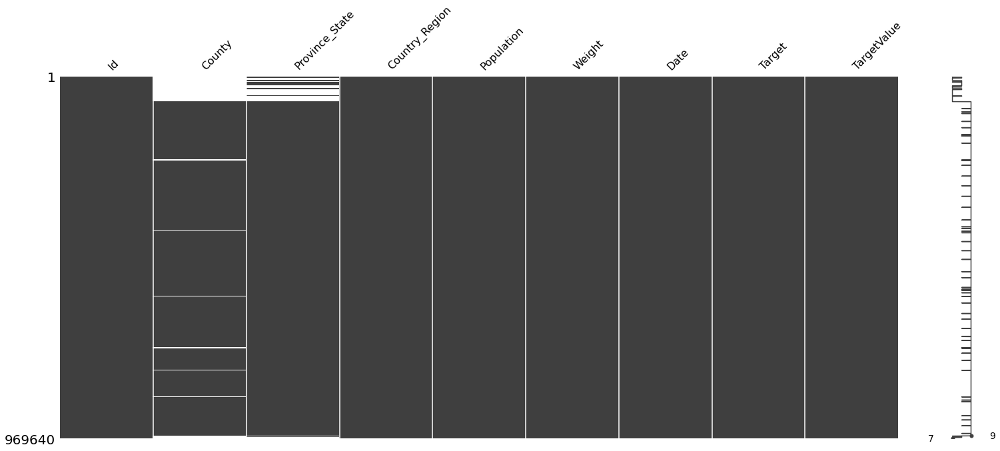

In [ ]:
import missingno as msno  # Visualize missing values
%matplotlib inline
msno.matrix(train)

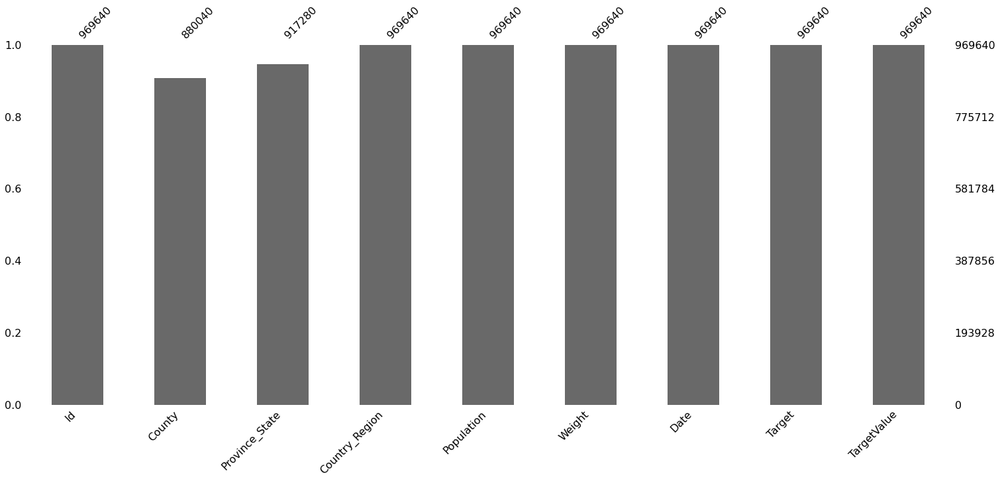

In [ ]:
msno.bar(train);

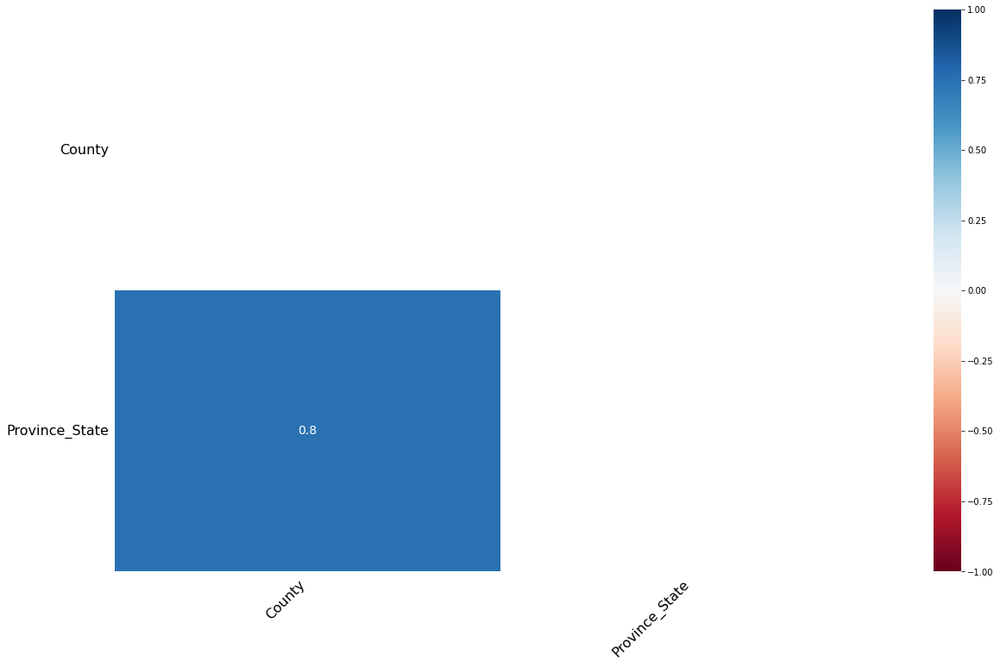

In [ ]:
msno.heatmap(train)

Observations 

Missing values for County and Province_State are highly correlated, meaning it is highly likely that the rows with missing county information will also have missing province_state information.

Missing values in the extra dataset

In [ ]:
print('NaN values =', extra.isnull().sum().sum())
print("""""")

vars_with_missing = []

for feature in extra.columns:
    missings = extra[feature].isna().sum()
    
    if missings > 0 :
        vars_with_missing.append(feature)
        missings_perc = missings / extra.shape[0]
        
        print('Variable {} has {} records ({:.2%}) with missing values.'.format(feature, missings, missings_perc))
print('In total, there are {} variables with missing values'.format(len(vars_with_missing)))

NaN values = 4147816

Variable continent has 8825 records (6.36%) with missing values.
Variable total_cases has 7728 records (5.57%) with missing values.
Variable new_cases has 7733 records (5.57%) with missing values.
Variable new_cases_smoothed has 8773 records (6.32%) with missing values.
Variable total_deaths has 19061 records (13.74%) with missing values.
Variable new_deaths has 18865 records (13.60%) with missing values.
Variable new_deaths_smoothed has 8773 records (6.32%) with missing values.
Variable total_cases_per_million has 8399 records (6.05%) with missing values.
Variable new_cases_per_million has 8404 records (6.06%) with missing values.
Variable new_cases_smoothed_per_million has 9439 records (6.80%) with missing values.
Variable total_deaths_per_million has 19719 records (14.21%) with missing values.
Variable new_deaths_per_million has 19523 records (14.07%) with missing values.
Variable new_deaths_smoothed_per_million has 9439 records (6.80%) with missing values.
Var

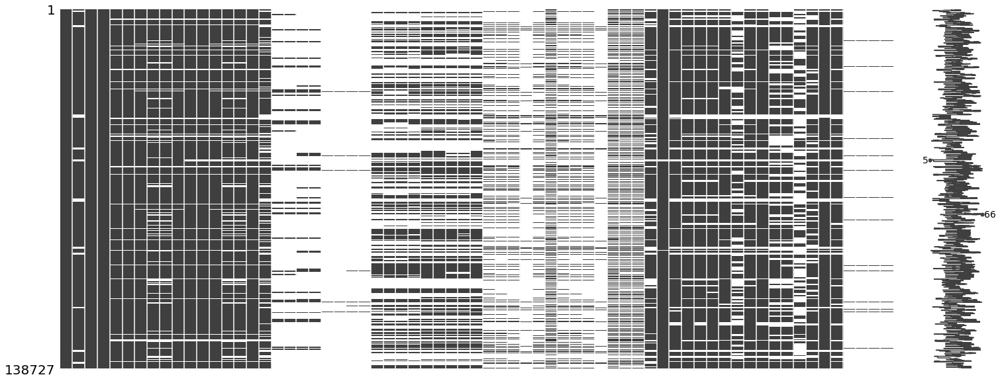

In [ ]:
import missingno as msno  # Visualize missing values
%matplotlib inline
msno.matrix(extra)

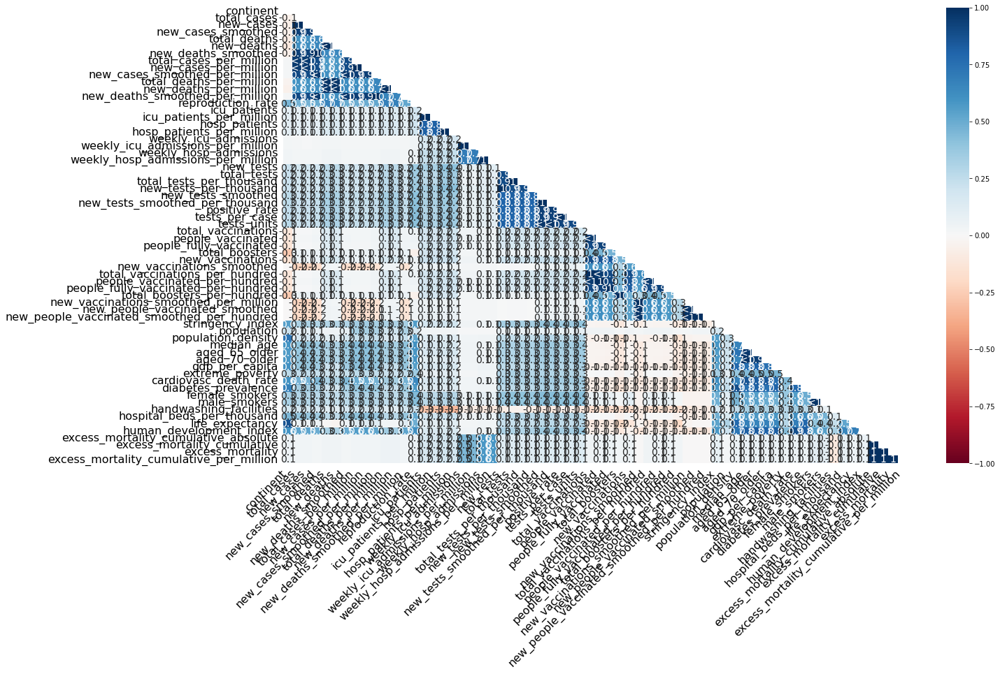

In [ ]:
msno.heatmap(extra)

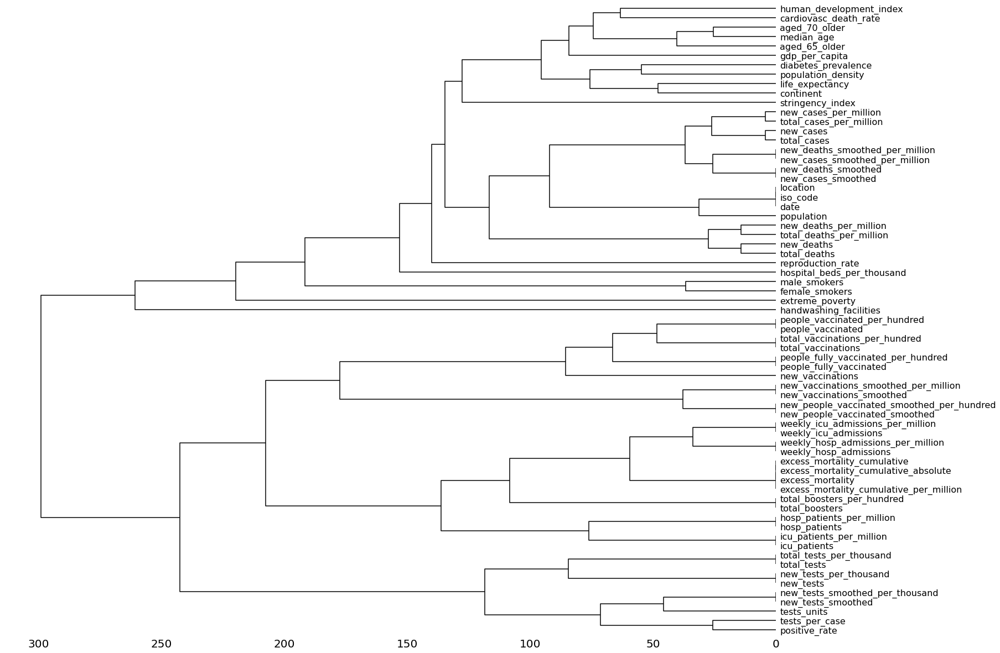

In [ ]:
msno.dendrogram(extra)


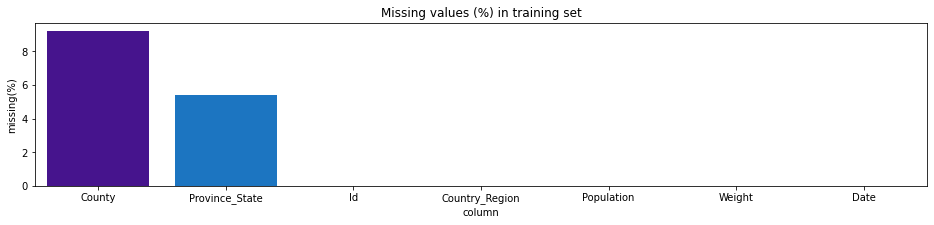

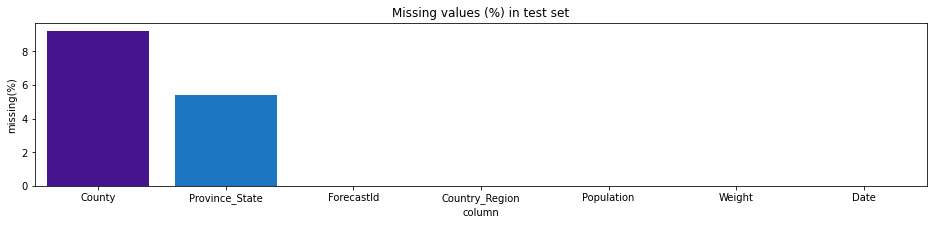

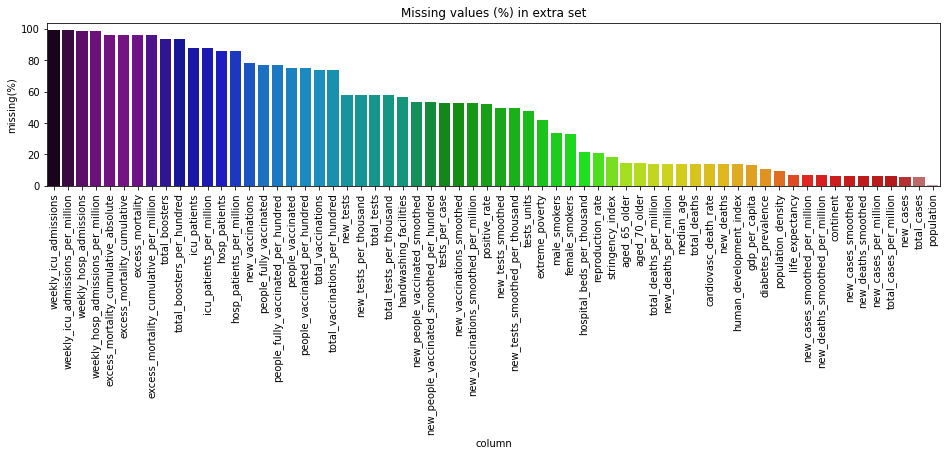

In [ ]:
df_missing_train = pd.DataFrame({'column':train.columns, 'missing(%)':((train.isna()).sum()/train.shape[0])*100})
df_missing_test = pd.DataFrame({'column':test.columns, 'missing(%)':((test.isna()).sum()/test.shape[0])*100})
df_missing_extra = pd.DataFrame({'column':extra.columns, 'missing(%)':((extra.isna()).sum()/extra.shape[0])*100})

df_missing_train_nl = df_missing_train.nlargest(7, 'missing(%)')
df_missing_test_nl = df_missing_test.nlargest(7, 'missing(%)')
df_missing_extra_nl = df_missing_extra.nlargest(64, 'missing(%)')

sns.set_palette(sns.color_palette('nipy_spectral'))

plt.figure(figsize=(16,3))
sns.barplot(data= df_missing_train_nl, x='column', y='missing(%)',palette='nipy_spectral')
plt.title('Missing values (%) in training set')
plt.show()

plt.figure(figsize=(16,3))
sns.barplot(data= df_missing_test_nl, x='column', y='missing(%)',palette='nipy_spectral')
plt.title('Missing values (%) in test set')
plt.show()

plt.figure(figsize=(16,3))
sns.barplot(data= df_missing_extra_nl, x='column', y='missing(%)',palette='nipy_spectral')
plt.xticks(rotation=90)
plt.title('Missing values (%) in extra set')
plt.show()

Observations: 
* Missing value proportions tend to be consistent across the **train** and **test** dataset
* Lots of features with high % of missing values in the extra dataset.
* Too many values to sensibly visualise in Extra data set. Will drop features with more than 40% initially.

In [ ]:
# dropping columns from extra dataset (missing more than 40%)
perc = 41.0 # Like N %
min_count =  int(((100-perc)/100)*extra.shape[0] + 1)
extra_dropna = extra.dropna( axis=1, 
                thresh=min_count)

In [ ]:
#check shape
extra_dropna.shape

(138727, 31)

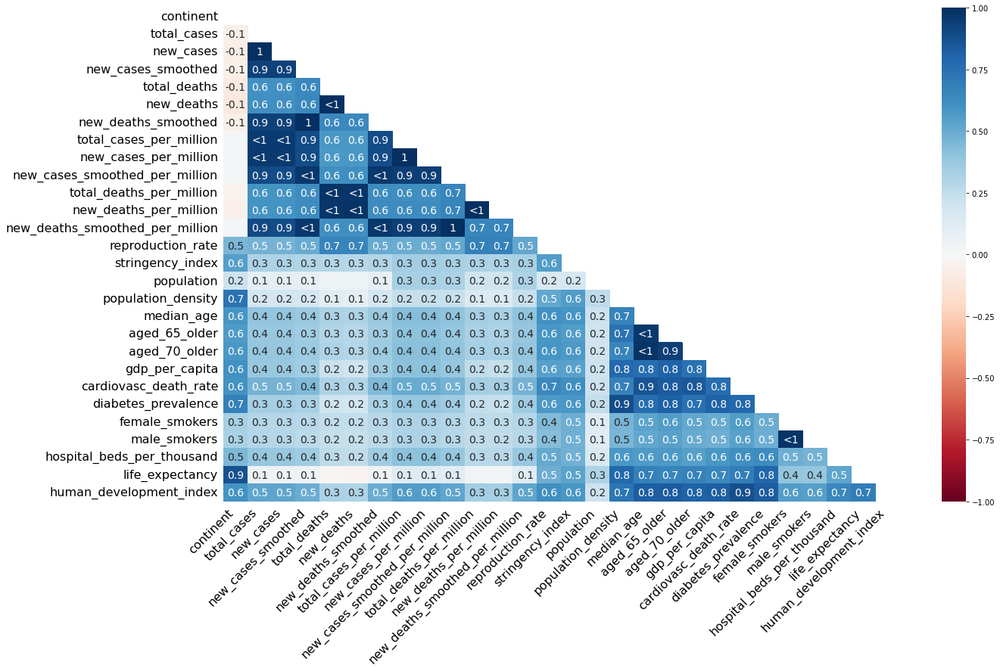

In [ ]:
msno.heatmap(extra_dropna)

##Observations:

* The graph above shows the correlation of misssing values in columns of the extra data set. 

* All missing values in the extra dataset are positively correlated with each other

* We can infer that the data is missing completely at random. 


## Univariate Exploration <a name='univariate_exploration'></a>

### Cardinality


Cardinality of train data

In [ ]:
var = meta2[(meta2.type == 'categorical') & (meta2.preserve)].index

for feature in var:
    dist_values = train[feature].value_counts().shape[0]
    print('Variable {} has {} distinct values'.format(feature, dist_values))

Variable County has 1840 distinct values
Variable Province_State has 133 distinct values
Variable Country_Region has 187 distinct values
Variable Date has 140 distinct values


Cardinality of extra data

In [ ]:
var = meta2_extra[(meta2_extra.type == 'categorical') & (meta2_extra.preserve)].index

for feature in var:
    dist_values = extra[feature].value_counts().shape[0]
    print('Variable {} has {} distinct values'.format(feature, dist_values))

Variable continent has 6 distinct values
Variable location has 237 distinct values
Variable date has 708 distinct values
Variable tests_units has 4 distinct values


### Real (Interval) features

Real type data in extra data

In [ ]:
variable = meta2_extra[(meta2_extra.type == 'real') & (meta2_extra.preserve)].index
extra[variable].describe()

,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,total_cases_per_million,new_cases_per_million,new_cases_smoothed_per_million,total_deaths_per_million,new_deaths_per_million,new_deaths_smoothed_per_million,reproduction_rate,icu_patients,icu_patients_per_million,hosp_patients,hosp_patients_per_million,weekly_icu_admissions,weekly_icu_admissions_per_million,weekly_hosp_admissions,weekly_hosp_admissions_per_million,new_tests,total_tests,total_tests_per_thousand,new_tests_per_thousand,new_tests_smoothed,new_tests_smoothed_per_thousand,positive_rate,tests_per_case,total_vaccinations,people_vaccinated,people_fully_vaccinated,total_boosters,new_vaccinations,new_vaccinations_smoothed,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,total_boosters_per_hundred,new_vaccinations_smoothed_per_million,new_people_vaccinated_smoothed,new_people_vaccinated_smoothed_per_hundred,stringency_index,population,population_density,median_age,aged_65_older,aged_70_older,gdp_per_capita,extreme_poverty,cardiovasc_death_rate,diabetes_prevalence,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
count,1.309990e+05,130994.000000,129954.000000,1.196660e+05,119862.000000,129954.000000,130328.000000,130323.000000,129288.000000,119008.000000,119204.000000,129288.000000,109605.000000,16963.000000,16963.000000,19376.000000,19376.000000,1319.000000,1319.000000,2206.000000,2206.000000,5.823400e+04,5.835300e+04,58353.000000,58234.000000,7.011400e+04,70114.000000,66029.000000,65368.000000,3.656800e+04,3.494700e+04,3.200000e+04,9.266000e+03,3.042800e+04,6.545800e+04,36568.000000,34947.000000,32000.000000,9266.000000,65458.000000,6.427200e+04,64272.000000,113130.000000,1.377390e+05,125560.000000,119573.000000,118253.000000,118921.000000,120342.000000,80399.000000,119755.000000,123788.000000,93274.000000,91928.000000,60278.000000,108801.000000,128970.000000,119877.000000,4894.000000,4894.000000,4894.000000,4894.000000
mean,2.180069e+06,8535.869185,8541.670343,5.305418e+04,182.800988,167.866251,21307.046606,90.895441,90.728166,427.014633,1.599307,1.465481,0.996771,880.803867,22.492191,4032.842744,158.120640,240.275208,17.453115,3286.737987,87.937592,5.899192e+04,1.303625e+07,552.504656,2.640108,5.525845e+04,2.510995,0.085544,159.320348,1.216407e+08,6.550145e+07,4.680933e+07,4.617128e+06,1.078695e+06,5.125888e+05,56.155438,31.875906,25.652141,3.538271,3402.799306,2.652450e+05,0.174553,55.867742,1.568339e+08,402.455697,30.492674,8.739950,5.528577,19229.336956,13.524469,260.152280,8.051101,10.589385,32.754137,50.839891,3.028244,73.262089,0.726055,33989.159706,9.265480,16.417652,843.997485
std,1.237657e+07,44427.334924,43803.864608,2.716035e+05,865.220373,812.301657,35035.087686,214.386916,181.142618,691.425161,4.133669,3.122105,0.340818,2774.447610,24.597334,11118.485731,212.268419,505.514554,32.637338,10467.769161,140.144869,1.986758e+05,5.290858e+07,1341.072341,7.213107,1.777492e+05,5.934275,0.095199,829.445808,5.660243e+08,3.100675e+08,2.339905e+08,1.901134e+07,4.130959e+06,2.799970e+06,52.927134,26.928519,24.909925,7.669485,4072.606081,2.437768e+06,0.276307,20.611001,7.269739e+08,1878.526494,9.114789,6.179346,4.213362,20084.851993,19.998348,119.886227,4.324373,10.502004,13.517123,31.817432,2.454183,7.528847,0.150018,95064.788868,17.389516,31.751464,1253.396483
min,1.000000e+00,-74347.000000,-6223.000000,1.000000e+00,-1918.000000,-232.143000,0.001000,-3125.829000,-272.971000,0.000000,-75.911000,-10.844000,-0.030000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000e+00,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000,0.000000,1.000000,0.000000e+00,0.000000e+00,1.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,

In [ ]:
data = []
for feature in extra_dropna.columns:
    # Defining the role
    if feature == 'iso_code':
        use = 'id'
    else:
        use = 'input'
         
    # Defining the type
    if extra_dropna[feature].dtype == object:
        type = 'categorical'
    elif extra_dropna[feature].dtype == float or isinstance(extra_dropna[feature].dtype, float):
        type = 'real'
    else:
        type = 'integer'
        
    # Initialize preserve to True for all variables except for id
    preserve = True
    if feature == 'iso_code':
        preserve = False
    
    # Defining the data type 
    dtype = extra_dropna[feature].dtype
    
    category = 'none'
    # Defining the category
    if feature == 'tests_units':
        category = 'info'
    elif feature == 'date':
        category = 'date'
    elif feature == 'location' or feature == 'continent':
        category = 'location'
    

    
    
    # Creating a Dict that contains all the metadata for the variable
    feature_dictionary = {
        'varname': feature,
        'use': use,
        'type': type,
        'preserve': preserve,
        'dtype': dtype,
        'category' : category
    }
    data.append(feature_dictionary)
    
meta2_extra_dropna = pd.DataFrame(data, columns=['varname', 'use', 'type', 'preserve', 'dtype', 'category'])
meta2_extra_dropna.set_index('varname', inplace=True)
meta2_extra_dropna



,use,type,preserve,dtype,category
varname,,,,,
iso_code,id,categorical,False,object,none
continent,input,categorical,True,object,location
location,input,categorical,True,object,location
date,input,categorical,True,object,date
total_cases,input,real,True,float64,none
new_cases,input,real,True,float64,none
new_cases_smoothed,input,real,True,float64,none
total_deaths,input,real,True,float64,none
new_deaths,input,real,True,float64,none


In [ ]:
extra_dropna.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 138727 entries, 0 to 138726
Data columns (total 31 columns):
 #   Column                           Non-Null Count   Dtype  
---  ------                           --------------   -----  
 0   iso_code                         138727 non-null  object 
 1   continent                        129902 non-null  object 
 2   location                         138727 non-null  object 
 3   date                             138727 non-null  object 
 4   total_cases                      130999 non-null  float64
 5   new_cases                        130994 non-null  float64
 6   new_cases_smoothed               129954 non-null  float64
 7   total_deaths                     119666 non-null  float64
 8   new_deaths                       119862 non-null  float64
 9   new_deaths_smoothed              129954 non-null  float64
 10  total_cases_per_million          130328 non-null  float64
 11  new_cases_per_million            130323 non-null  float64
 12  ne

In [ ]:
fig = make_subplots(rows=1, cols=4)
# Use x instead of y argument for horizontal plot
fig.add_trace(go.Box(y=extra['reproduction_rate'], name='reproduction rate'),row=1,col=1)
fig.add_trace(go.Box(y=extra['population_density'], name='population density'),row=1,col=2) # can it show beloew 10k and the 2 outliers?
fig.add_trace(go.Box(y=extra['median_age'], name='median age'),row=1,col=3)
fig.add_trace(go.Box(y=extra['human_development_index'], name='human development index'),row=1,col=4)
fig.show() 

Output hidden; open in https://colab.research.google.com to view.

### Observations

The figure above shows that there are outliers in the features: population densisty and reproduction rate.

These columns would need to be scaled before they are put through a ML model

## Bivariate Exploration <a name='bivariate_exploration'></a>

### Real (Interval) features

In [ ]:
def corr_heatmap(sample, masking=False):
    sns.set_style('whitegrid')
    # Create color map ranging between two colors
    cmap = sns.diverging_palette(50, 10, as_cmap=True)
    fig, ax = plt.subplots(figsize=(10,10))
    
    if masking==False:
        correlations = sample.corr()
        sns.heatmap(correlations, cmap=cmap, vmax=1.0, center=0, fmt='.2f', 
                    square=True, linewidths=.5, annot=True, cbar_kws={"shrink": .75})
    else:
        correlations = np.triu(sample.corr())
        sns.heatmap(sample.corr(), cmap=cmap, vmax=1.0, center=0, fmt='.2f',
                square=True, linewidths=.5, annot=True, cbar_kws={"shrink": .75}, 
                    mask=correlations)
    plt.show();    

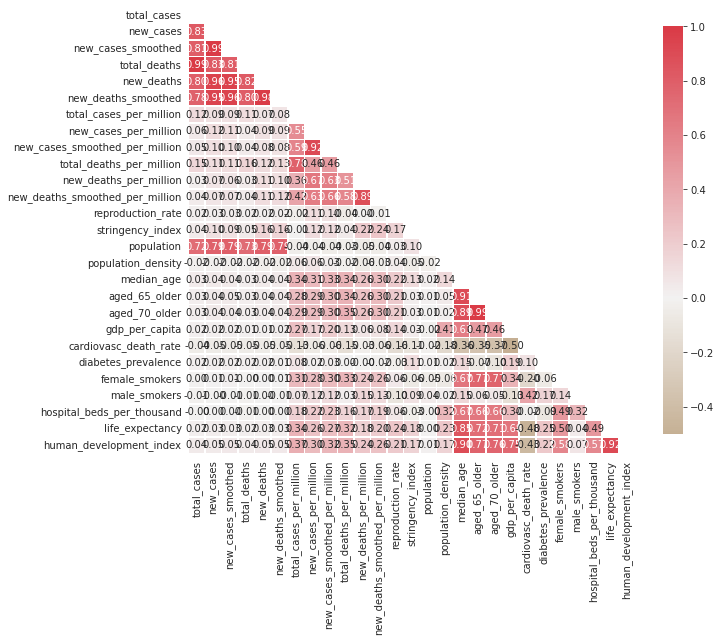

In [ ]:
# much easier to read compared to the graph without dropped features
sample = extra_dropna.sample(1000)
var = meta2_extra_dropna[(meta2_extra_dropna.type == 'real') & (meta2_extra_dropna.preserve)].index
sample = sample[var]
corr_heatmap(sample, masking=True)

Observations:

No clear observations can be made from this graph as there are too many features 

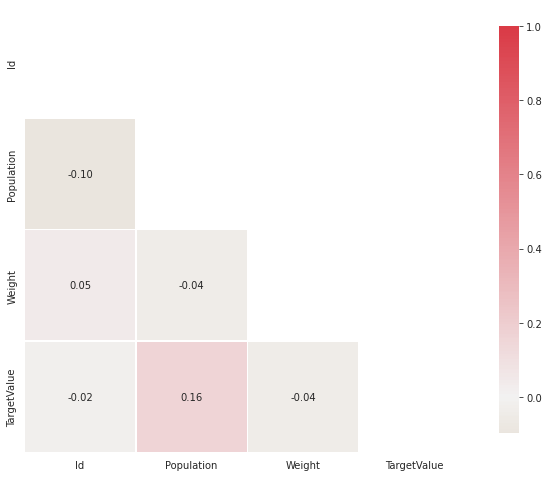

In [ ]:
corr_heatmap(train, masking=True)

Observation: 
* No obvious correlations between any of the features in the train dataset.

* very weak correaltion between targetvalue and population

 

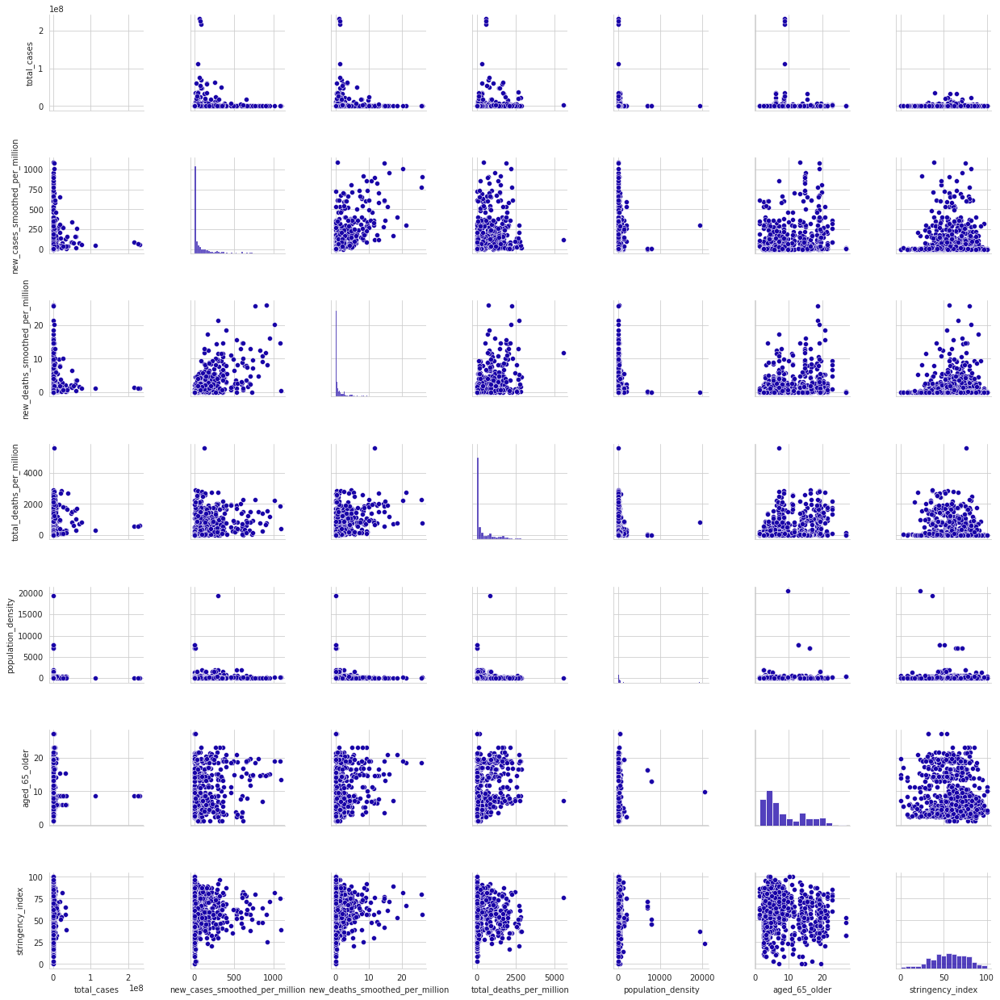

In [ ]:
# car categories - needs changing to COVID columns
sample = extra_dropna.sample(1000)
var = ['iso_code', 'total_cases', 
       'new_cases_smoothed_per_million', 'new_deaths_smoothed_per_million', 
       'total_deaths_per_million', 'population_density',
       'aged_65_older', 'stringency_index']
sample = sample[var]

sns.pairplot(sample)

#sns.pairplot(sample,  hue='target', 
#            palette = 'Set1', diag_kind='kde')
plt.show()

Observation.

* We have visualized the features in the Real(Interval) variables using Pairplot.
* By seeing at the cluster of graphs we can say that the some columns are corelated For eg: New cases smoothed per million which is on X axis and the New deaths smoothed per million which is on y axis have a positive corelation.




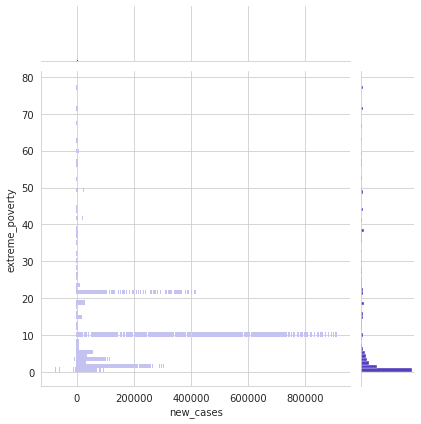

In [ ]:
sns.jointplot(x='new_cases', y='extreme_poverty', data=extra, 
              kind="hist")

Observation.

* We have visualise the correlation between extreme poverty and new cases features in the real (Interval) variables using joint-plot.

* The graphs showsthat in countries less burdened by poverty, they have more cases of COVID-19


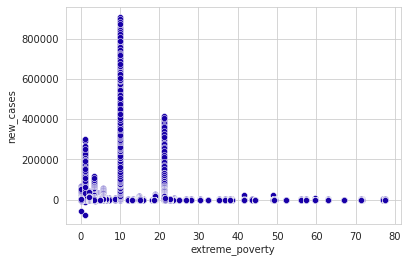

In [ ]:
sns.scatterplot(x='extreme_poverty',y='new_cases',data=extra)

this graph shows that with increase in poverty there is less number of cases but there is a possibility that in some countries due to lack of medical amenities and high cost of health care ,cases are not reported.

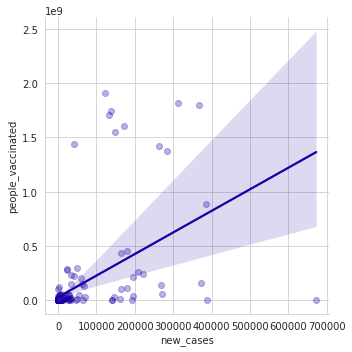

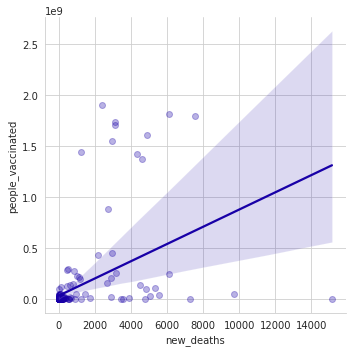

In [ ]:
sample_nc = extra.sample(1000)
var_nc = ['new_cases', 'new_deaths', 'people_vaccinated']
sample_nc = sample_nc[var_nc]

sns.lmplot(x='new_cases', y='people_vaccinated', data=sample_nc, palette='Set1', scatter_kws={'alpha':0.3})


sns.lmplot(x='new_deaths', y='people_vaccinated', data=sample_nc, palette='Set1', scatter_kws={'alpha':0.3})


plt.show()

Observation.

* Here, the first Implot shows the people who are vaccinated vs the new cases  so as the new cases are going up, the mre people are getting vaccinated. 
* Both graphs show a positive correlation between deaths, cases and Vaccinations

* However, the gradient is lower in the second graph, it shows the relationship between the people who are vaccinated vs the new deaths are which means the there is increase in the new deaths but more people are getting vaccinated.

 

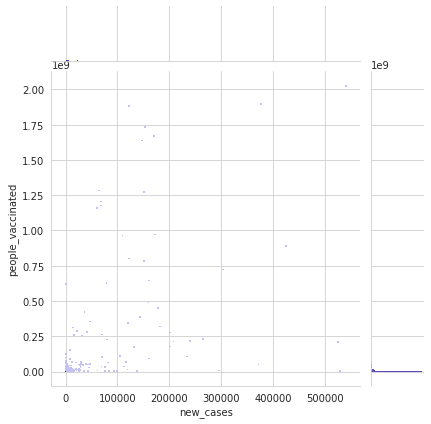

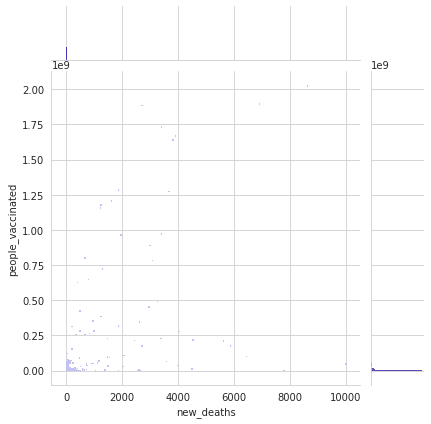

In [ ]:
sample_nc = extra.sample(2000)
var_nc = ['new_cases', 'new_deaths', 'people_vaccinated']
sample_nc = sample_nc[var_nc]

sns.jointplot(x='new_cases', y='people_vaccinated', data=sample_nc, kind="hist")

sns.jointplot(x='new_deaths', y='people_vaccinated', data=sample_nc, kind="hist")

plt.show()

Observation:

No observation can be made as it is quite difficult to infer from a small graph

### Integer (Ordinal) features

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



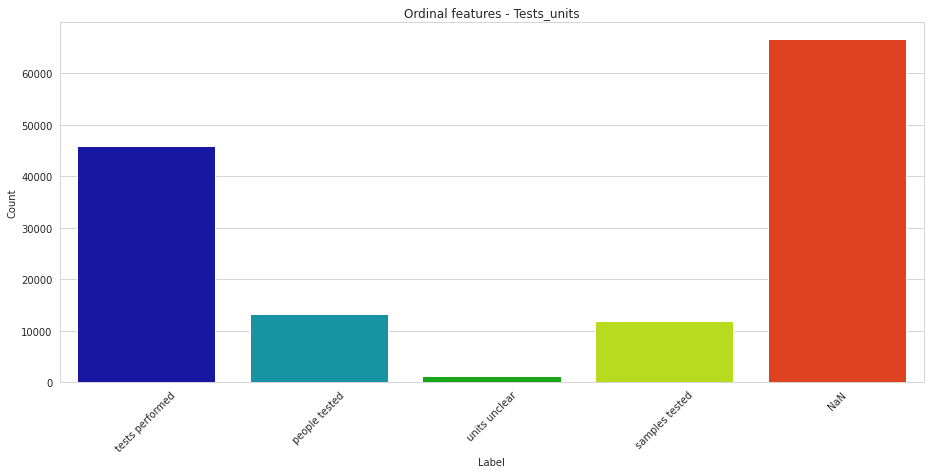

In [ ]:

# Removed if type(cat) == str: line as it prevented the chart from being produced 
cats = extra['tests_units'].unique()
tests_units_cat_list = []
tests_units_sum_list = []

for cat in cats:
    tests_units_cat_list.append(cat)
    tests_units_sum_list.append(extra[extra['tests_units'] == cat].shape[0])

#NaN handling
tests_units_cat_list.append('NaN')
tests_units_sum_list.append(extra['tests_units'].isna().sum())

fig = plt.figure(figsize=(12,5))
ax = fig.add_axes([0,0,1,1])
sns.barplot(tests_units_cat_list,tests_units_sum_list,palette='nipy_spectral')
plt.xticks(rotation=45)
ax.set_ylabel('Count')
ax.set_xlabel('Label')
plt.title('Ordinal features - Tests_units')
plt.show()

Observations:

This graph showing the ordinal feature test_units, shows that the majority of the records are missing (around 60500)

## Other EDAs 
other EDAs that are not in lab work

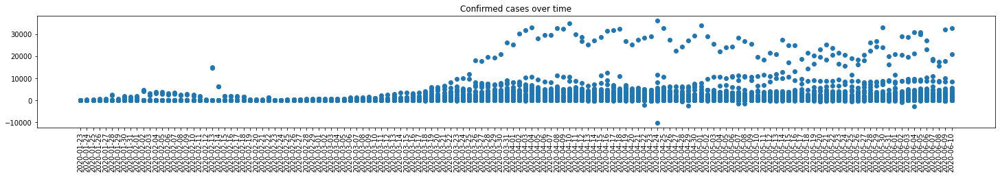

In [ ]:
x = train[train['Target'] == 'ConfirmedCases']['Date']
y = train[train['Target'] == 'ConfirmedCases']['TargetValue']


plt.figure(figsize=(25,3))
plt.scatter(x, y, cmap=train['Country_Region'])
plt.xticks(rotation=90)
plt.title('Confirmed cases over time')
plt.show()

* In Febuary the rate of confirmed cases were lower than 20k.
* After mid March the caonfirmed cases started to rise over 30k.


In [ ]:
grouped_data= train.groupby('Country_Region').sum()

top_10_pop_countries= grouped_data.nlargest(10,'Population')['TargetValue']

top_10_pop_countries

Country_Region
China          176564
India          284328
US            6317214
Indonesia       36275
Brazil         812096
Pakistan       115957
Nigeria         14255
Bangladesh      75877
Russia         499373
Japan           18066
Name: TargetValue, dtype: int64

In [ ]:
train['Date']= pd.to_datetime(train['Date'])
test['Date']= pd.to_datetime(test['Date'])

In [ ]:
date_grouped_data= train.groupby('Date').sum()

fig = px.line(x= date_grouped_data.index, y= date_grouped_data['TargetValue'], title= 'growth of covid cases over time', labels= dict( x='Date', y='Number of covid cases'))
fig.show()

# BHAVYA KHURANA. (2021.) COVID-19 Global Forcasting. (Version 1.) [Source Code]. https://www.kaggle.com/bhavyakhurana/covid-19-global-forcasting#DATA-PROCESSING

* There was a spike on Feb 12 with 802 cases.
* There was a exponential growth on march 12 after that the rises in cases where seen.
* The maximum amount of cases where seen on June 5 which was 205.329k. 


###Time Series - Seasonality

In [ ]:
df_dict = {'test':test,
           'train':train
          }

for key, value in df_dict.items():
    #print('--------'+key+'---------')
    value.columns = value.columns.str.lower()
    #print(value.head())
    #print(value.info())

In [ ]:
'''
Function to provide alpha 2 codes for each country
'''
def findCountry(country_name):
    '''
    try-except as some alpha codes need manual input
    '''
    try:
        return pycountry.countries.get(name=country_name).alpha_2
    except:
        return ("not found")
train['country_alpha_2'] = train.country_region.apply(findCountry)

In [ ]:
#Countries that need manual alpha 2 input
train.country_region[train.country_alpha_2=='not found'].value_counts()

US                     895440
Moldova                   280
Congo (Brazzaville)       280
Kosovo                    280
Bolivia                   280
Korea, South              280
Diamond Princess          280
Burma                     280
Vietnam                   280
Taiwan*                   280
Brunei                    280
Syria                     280
Holy See                  280
Congo (Kinshasa)          280
Laos                      280
MS Zaandam                280
Cote d'Ivoire             280
Russia                    280
Tanzania                  280
Iran                      280
West Bank and Gaza        280
Venezuela                 280
Name: country_region, dtype: int64

In [ ]:
train[train['country_region']=='US'].head()

,id,county,province_state,country_region,population,weight,date,target,targetvalue,country_alpha_2
67760,67761,Autauga,Alabama,US,55869,0.091485,2020-01-23,ConfirmedCases,0,not found
67761,67762,Autauga,Alabama,US,55869,0.914848,2020-01-23,Fatalities,0,not found
67762,67763,Autauga,Alabama,US,55869,0.091485,2020-01-24,ConfirmedCases,0,not found
67763,67764,Autauga,Alabama,US,55869,0.914848,2020-01-24,Fatalities,0,not found
67764,67765,Autauga,Alabama,US,55869,0.091485,2020-01-25,ConfirmedCases,0,not found


In [ ]:
#Dictionary containing missing countries' alpha 2
alpha_2_dict = {
    'Korea':'KR',
    'Korea, South':'KR',
    'Congo (Brazzaville)':'CG',
    'Laos':'LA',
    'Moldova':'MD',
    'Brunei':'BN',
    'Bolivia':'BO',
    'Russia':'RU',
    'Vietnam':'VN',
    'Venezuela':'VE',
    'Cote d\'Ivoire':'CI',
    'Taiwan':'TW',
    'West Bank and Gaza':'PS',
    'Iran':'IR',
    'Tanzania':'TZ',
    'Syria':'SY',
    'Congo (Kinshasa)':'CD',
    'US':'US',
    'Kosovo':'RS',
    'Burma':'MM',
    'MS Zaandam':'NL',
    'Taiwan*':'TW',
    'Holy See':'IT',
    'Diamond Princess':'JP'

}


In [ ]:
#Apply the dictionary to dataframe, mapping to alpha 2 column
train.loc[train.country_alpha_2=='not found', 'country_alpha_2']=train.country_region.map(alpha_2_dict)

In [ ]:
#Check if above worked
train.country_alpha_2.value_counts()

US    895440
CN      9520
CA      3640
FR      3080
GB      3080
       ...  
VE       280
SS       280
ME       280
BR       280
UY       280
Name: country_alpha_2, Length: 183, dtype: int64

In [ ]:
#Set continent from alhpa 2
def alpha2_to_continent(alpha2):
    #country_alpha2 = pc.country_name_to_country_alpha2(country_name)
    try:
        country_continent_code = pc.country_alpha2_to_continent_code(alpha2)
        country_continent_name = pc.convert_continent_code_to_continent_name(country_continent_code)
        return country_continent_name
    except:
        return ('error')

In [ ]:
#Apply the alpha2_to_continent function
train['continent'] = train['country_alpha_2'].apply(alpha2_to_continent)

In [ ]:
#Check if above worked
train.continent.value_counts()

North America    904960
Asia              22400
Europe            20160
Africa            14840
Oceania            3360
South America      3360
error               560
Name: continent, dtype: int64

In [ ]:
#Show what alpha 2 codes need manual input
train.country_region[train.continent=='error'].value_counts()

Western Sahara    280
Timor-Leste       280
Name: country_region, dtype: int64

In [ ]:
#Show what alpha 2 codes need manual input
train.country_alpha_2[train.continent=='error'].value_counts()

EH    280
TL    280
Name: country_alpha_2, dtype: int64

In [ ]:
#Replace 'error' with Africa as missing value is only from Western Sahara
#If any others missing this will be ineffective
train.loc[train.continent=='error', 'continent']='Africa'

In [ ]:
#Check if error value has been removed
train.continent.value_counts()

North America    904960
Asia              22400
Europe            20160
Africa            15400
Oceania            3360
South America      3360
Name: continent, dtype: int64

In [ ]:
#Convert date column to datetime dtype
train.date = pd.to_datetime(train.date)

In [ ]:
#create a copy of the dataframe
seasonal_analysis = train.copy()

In [ ]:
#Dataframe containing useful columns for timeseries
seasonal_analysis_short = seasonal_analysis[['date', 'continent', 'target', 'targetvalue']]

In [ ]:
seasonal_analysis_short.head()

,date,continent,target,targetvalue
0,2020-01-23,Asia,ConfirmedCases,0
1,2020-01-23,Asia,Fatalities,0
2,2020-01-24,Asia,ConfirmedCases,0
3,2020-01-24,Asia,Fatalities,0
4,2020-01-25,Asia,ConfirmedCases,0


In [ ]:
#Split dataframe into confirmedcases and fatalities
confirmed_cases = seasonal_analysis_short[seasonal_analysis_short['target']=='ConfirmedCases']
fatal_cases = seasonal_analysis_short[seasonal_analysis_short['target']=='Fatalities']

In [ ]:
#remove target column and set the index to date column
confirmed_cases = confirmed_cases.drop(['target'], axis=1)
confirmed_cases = confirmed_cases.set_index('date')

fatal_cases = fatal_cases.drop(['target'], axis=1)
fatal_cases = fatal_cases.set_index('date')

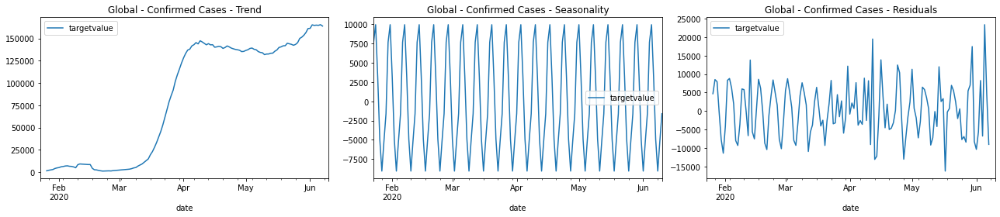

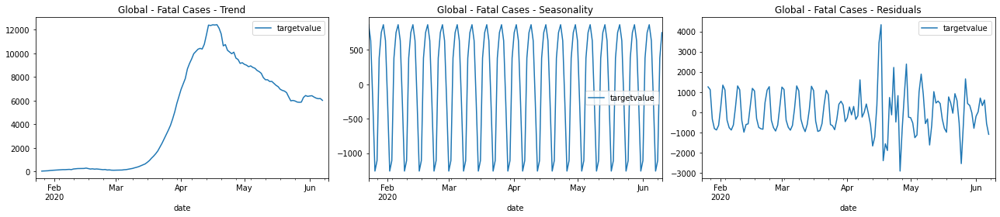

In [ ]:
'''
List containing both dataframes
'''
case_types = {
    'Confirmed Cases':confirmed_cases,
    'Fatal Cases':fatal_cases
    }

'''
Loop through both dataframes
'''
for case_type_key, case_type_value in case_types.items():
    

      '''
      Create a variable to be used in each iteration,
      Filter to the specific continent
      Drop continent column
      Resample the data to x days
      '''
      temp = case_type_value.drop('continent', axis=1)
      temp = temp.resample('1D').sum() #resample value change for trend over different periods

      '''
      Plot seasonal decomposition info
      '''
      decomposed_cases = seasonal_decompose(temp)
      plt.figure(figsize=(18, 4))
      plt.subplot(131)
      decomposed_cases.trend.plot(ax=plt.gca())
      plt.title('Global - {} - Trend'.format(case_type_key))
      plt.subplot(132)
      decomposed_cases.seasonal.plot(ax=plt.gca())
      plt.title('Global - {} - Seasonality'.format(case_type_key))
      plt.subplot(133)
      decomposed_cases.resid.plot(ax=plt.gca())
      plt.title('Global - {} - Residuals'.format(case_type_key))
      plt.tight_layout()

Location|Trend|Seasonality|Residual
---|---|---|---
GLOBAL - Confirmed Cases|The trend spikes at mid-March of 2020 with cases from <10,000 per day <br>to almost 150,000 per day at the start of April, where it continues around 150,000 <br>until June where it spikes again.  |Seasonality follows a weekly pattern that fluctuates between +10,000 and -7,500| 
GLOBAL - Fatal Cases|Trend follows same pattern as confirmed cases, spike in mid-March <1000 <br>to <13,000 beginning of April, however it declines in mid-April back down to around 6,000 per day|Seasonality also follows the same weekly pattern between +750 and -1,250|


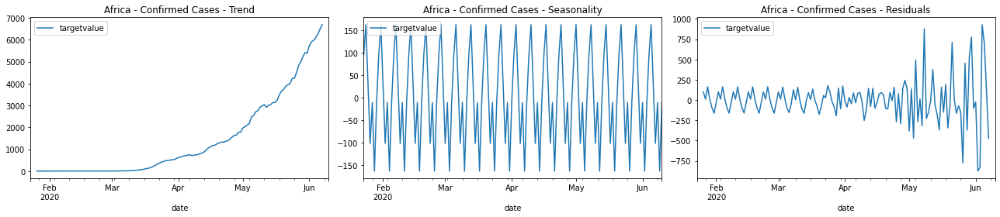

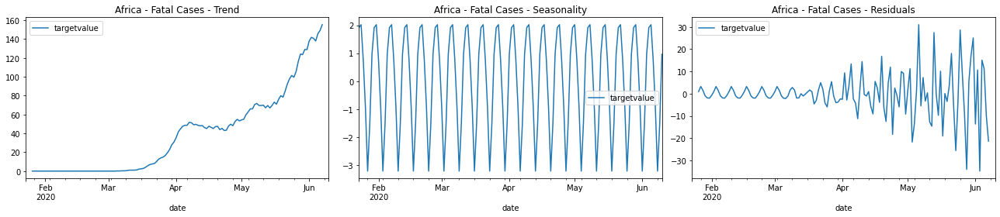

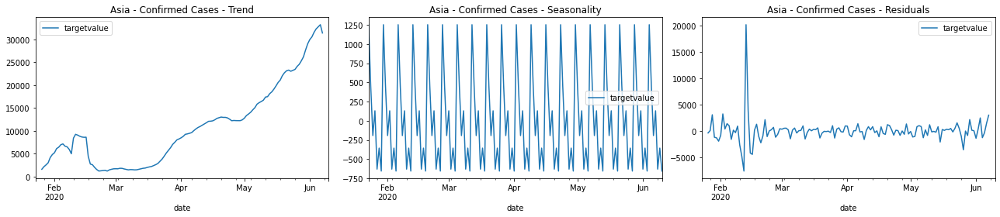

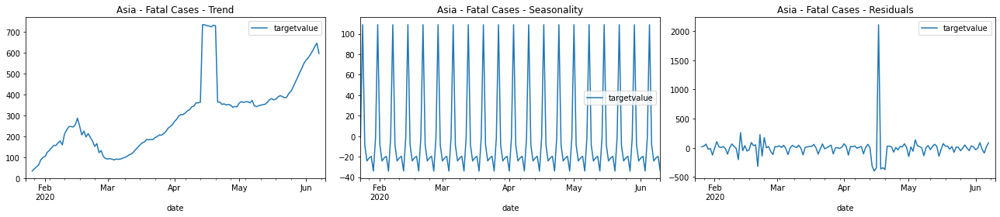

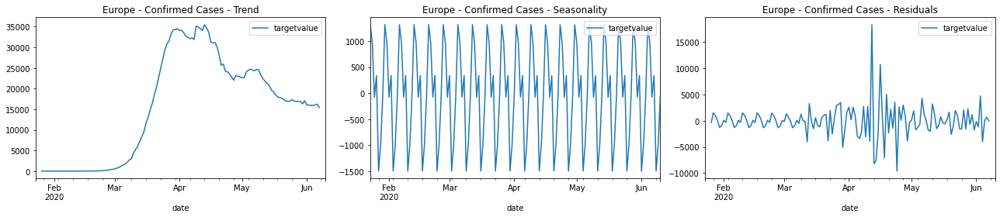

...

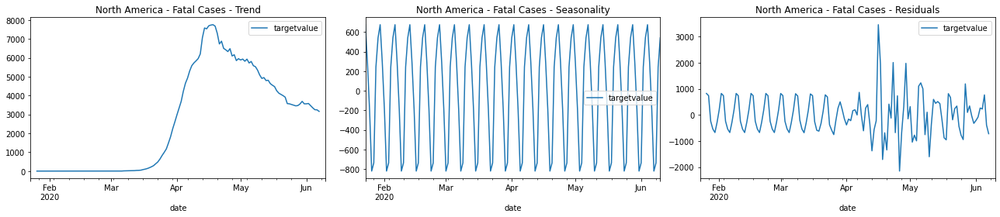

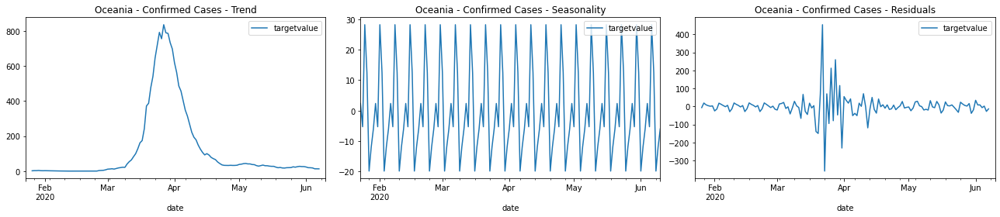

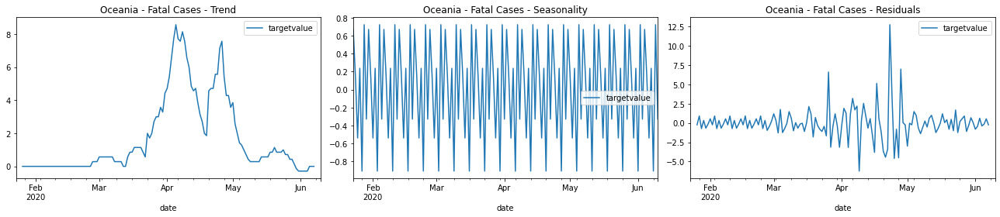

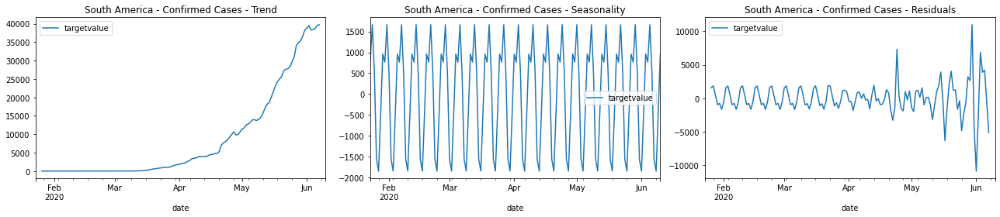

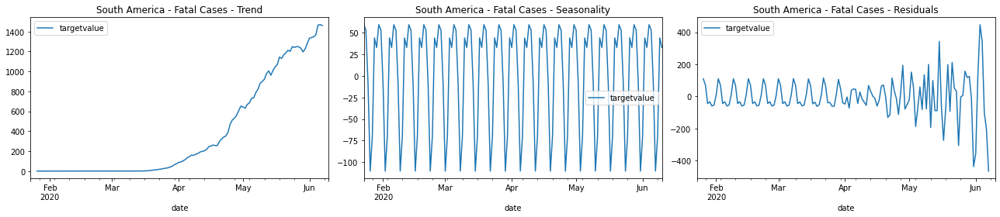

In [ ]:
'''
List containing each continent
'''
continents = [
    'Africa',
    'Asia',
    'Europe',
    'North America',
    'Oceania',
    'South America'
]

'''
List containing both dataframes
'''
case_types = {
    'Confirmed Cases':confirmed_cases,
    'Fatal Cases':fatal_cases
    }
'''
Loop through each continent
'''
for continent in continents:
  '''
  Loop through both dataframes
  '''
  for case_type_key, case_type_value in case_types.items():
    
    

        '''
        Create a variable to be used in each iteration,
        Filter to the specific continent
        Drop continent column
        Resample the data to x days
        '''
        temp = case_type_value[case_type_value['continent']==continent]
        temp = temp.drop('continent', axis=1)
        temp = temp.resample('1D').sum() #resample value change for trend over different periods

        '''
        Plot seasonal decomposition info
        '''
        decomposed_cases = seasonal_decompose(temp)
        plt.figure(figsize=(18, 4))
        plt.subplot(131)
        decomposed_cases.trend.plot(ax=plt.gca())
        plt.title('{} - {} - Trend'.format(continent, case_type_key))
        plt.subplot(132)
        decomposed_cases.seasonal.plot(ax=plt.gca())
        plt.title('{} - {} - Seasonality'.format(continent, case_type_key))
        plt.subplot(133)
        decomposed_cases.resid.plot(ax=plt.gca())
        plt.title('{} - {} - Residuals'.format(continent, case_type_key))
        plt.tight_layout()

Location|Trend|Seasonality|Residual
---|---|---|---
Africa - Confirmed|Sub 1000 cases to mid-March, spikes to 100,000 at start of April, slowly declines to 75,000 in June||
Africa - Fatal|Similar trend to confirmed, spike is mid-April with 7,000 daily fatalities||
Asia - Confirmed|Asia is the only continent to spike cases between mid-January and mid-February up to 10,000 a day,<br> cases drops down to sub 1,000 until mid-March, where cases steadily increase to 30,000 daily in June ||
Asia - Fatal|Same trend as confirmed, however large spike in mid-April to 700 that drops to normal levels in roughly 1 week.<br> Flattens during May around 400 fatalities, then increases to 650 in June.||
Europe - Confirmed|Sub 1000 cases to mid-March, spikes to 35,000 at start of April, slowly declines to 15,000 in June||
Europe - Fatal|Same pattern up to April with 4000 fatalities, steeper decrease between April and June||
North America - Confirmed|Low cases until mid-March, steady increase to 7,000 cases per day in June||
North America - Fatal|Fatal cases increase at beginning of April, steady climb to 800 per day in June||
Oceania - Confirmed|Cases spike mid-March to 800, drop to under 50 by mid-April||
Oceania - Fatal|Fatalities climb mid-March, peak start of April with 8 daily, drops to normal level at start of May||
South America - Confirmed|Cases steadily increase from mid-March to 40,000 daily in June||
South America - Fatal|Fatal cases follows the same pattarn, peaking at 1,400 daily in June||


The trends for continent data begin at different points in time, the order of cases first appearing goes; <br>Asia, <br>Oceania, <br>Europe, <br>North America,  <br>Africa, <br> South America.<br>

Some continents have been hit harder than others, Africa is the worst off with a peak over 100,000, and South America being 2nd with a peak of 40,000. <br>Oceania had the lowest peak with 800, followed by North America with 7,000. 

Seasonality for all graphs follow a weekly pattern.              

In [ ]:
temp_train = train.copy()

# *SIR* Graphical Visualisation_ Japan

In [ ]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)



pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 200)

# BHIROYUKI ICHIJO. (2021.) SIR Fitting. (Version 1.) [Source Code]. https://www.kaggle.com/ichijo/sir-fitting

In [ ]:
sir_train = pd.read_csv('train.csv')
sir_test = pd.read_csv('test.csv')
print(sir_train.head())
print(sir_test.head())
train_jp = sir_train[sir_train['Country_Region']=='Japan'].copy()
test_jp = sir_test[sir_test['Country_Region']=='Japan'].copy()
train_jp.drop(['County', 'Province_State'], axis=1,  inplace=True)
test_jp.drop(['County', 'Province_State'], axis=1,  inplace=True)
print(train_jp.info())
print(test_jp.info())

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning:

Columns (1) have mixed types.Specify dtype option on import or set low_memory=False.



   Id County Province_State Country_Region  Population    Weight        Date          Target  TargetValue
0   1    NaN            NaN    Afghanistan    27657145  0.058359  2020-01-23  ConfirmedCases            0
1   2    NaN            NaN    Afghanistan    27657145  0.583587  2020-01-23      Fatalities            0
2   3    NaN            NaN    Afghanistan    27657145  0.058359  2020-01-24  ConfirmedCases            0
3   4    NaN            NaN    Afghanistan    27657145  0.583587  2020-01-24      Fatalities            0
4   5    NaN            NaN    Afghanistan    27657145  0.058359  2020-01-25  ConfirmedCases            0
   ForecastId County Province_State Country_Region  Population    Weight        Date          Target
0           1    NaN            NaN    Afghanistan    27657145  0.058359  2020-04-27  ConfirmedCases
1           2    NaN            NaN    Afghanistan    27657145  0.583587  2020-04-27      Fatalities
2           3    NaN            NaN    Afghanistan    2765714

In [ ]:
train_jp['Date'] = pd.to_datetime(train_jp.Date)
train_jp['dayofyear'] = train_jp.Date.dt.dayofyear
train_jp_c = train_jp[train_jp.Target=='ConfirmedCases']
train_jp_f = train_jp[train_jp.Target=='Fatalities']
train_jp_c.tail()

,Id,Country_Region,Population,Weight,Date,Target,TargetValue,dayofyear
42830,42831,Japan,126960000,0.053592,2020-06-06,ConfirmedCases,42,158
42832,42833,Japan,126960000,0.053592,2020-06-07,ConfirmedCases,39,159
42834,42835,Japan,126960000,0.053592,2020-06-08,ConfirmedCases,21,160
42836,42837,Japan,126960000,0.053592,2020-06-09,ConfirmedCases,51,161
42838,42839,Japan,126960000,0.053592,2020-06-10,ConfirmedCases,35,162


In [ ]:
test_jp['Date'] = pd.to_datetime(test_jp.Date)
test_jp['dayofyear'] = test_jp.Date.dt.dayofyear
test_jp_c = test_jp[test_jp.Target=='ConfirmedCases']
test_jp_f = test_jp[test_jp.Target=='Fatalities']
test_jp_c.head()

,ForecastId,Country_Region,Population,Weight,Date,Target,dayofyear
13680,13681,Japan,126960000,0.053592,2020-04-27,ConfirmedCases,118
13682,13683,Japan,126960000,0.053592,2020-04-28,ConfirmedCases,119
13684,13685,Japan,126960000,0.053592,2020-04-29,ConfirmedCases,120
13686,13687,Japan,126960000,0.053592,2020-04-30,ConfirmedCases,121
13688,13689,Japan,126960000,0.053592,2020-05-01,ConfirmedCases,122


In [ ]:
# The 3/4 of population might not be infected finally.
population = train_jp.Population.iloc[0]/4
# b = 1.5 # infecters per week
# c = 0.5 # recover ratio
# d = 0.1 # death ratio
t_arr = np.array(train_jp_c.dayofyear)
y_arr = np.array(train_jp_c.TargetValue)
test_t_arr = np.array(test_jp_c.dayofyear)

# Start from the data has more than 10 infects.
start_day = list(y_arr>=10).index(True)
print(start_day)

t_arr = t_arr[start_day:]
y_arr = y_arr[start_day:]
t_arr_first = t_arr[0]
t_arr -= t_arr_first
test_t_arr -= t_arr_first

23


In [ ]:
# cleansing
for i,n in enumerate(y_arr):
    if n > 0:
        if n > 1000:
            y_arr[i] = (y_arr[i-1] + y_arr[i+1]) / 2
        else:
            continue
    else:
        y_arr[i] = (y_arr[i-1] + y_arr[i+1]) / 2

In [ ]:
from scipy import integrate, optimize


susceptible_0 = population - y_arr[0]
infected_0 = y_arr[0]

def sir(y,t,b,c,d):
    susceptible = -b * y[0] * y[1] / susceptible_0
    recovered = c * y[1]
    fatarities = d * y[1]
    infected = -(susceptible + recovered + fatarities)
    return susceptible,infected,recovered,fatarities

def inf_odeint(t,b,c,d):
    return integrate.odeint(sir,(susceptible_0,infected_0,0,0),t,args=(b,c,d))[:,1]

popt, pcov = optimize.curve_fit(inf_odeint, t_arr, y_arr)


In [ ]:
# fitted = inf_odeint(np.append(t_arr,test_t_arr), *popt)
fitted = inf_odeint(t_arr, *popt)


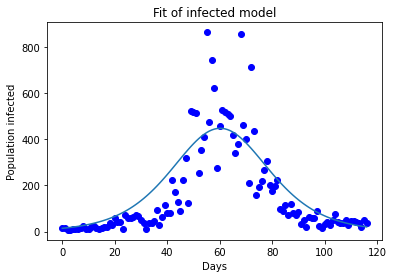

In [ ]:
import matplotlib.pyplot as plt

plt.plot(t_arr, y_arr, 'bo')
# plt.plot(np.append(t_arr,test_t_arr), fitted)
plt.plot(t_arr, fitted)

plt.title("Fit of infected model")
plt.ylabel("Population infected")
plt.xlabel("Days")
plt.show()

The above graph shows the fit of the SIR (susceptible, recovered, fatalities and infected) model for Japan over the dataset. In our research we realised this could be a really effective way to fit data to a model to predict health / infection trends. However, unfortunately, we ran out of time to try and apply this to our dataset further than including the graph representation above. If we were to do something like this in the future we would include SIR modelling.

# Data Preparation

In [ ]:
#Creating a savepoint
train_savepoint1 = train.copy()
test_savepoint1 = test.copy()

##Dropping Columns

In [ ]:
# Drop the null columns, which are County and Province_State
train.dropna(axis=1, inplace = True)
test.dropna(axis=1, inplace=True) 

In [ ]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 969640 entries, 0 to 969639
Data columns (total 9 columns):
 #   Column           Non-Null Count   Dtype         
---  ------           --------------   -----         
 0   id               969640 non-null  int64         
 1   country_region   969640 non-null  object        
 2   population       969640 non-null  int64         
 3   weight           969640 non-null  float64       
 4   date             969640 non-null  datetime64[ns]
 5   target           969640 non-null  object        
 6   targetvalue      969640 non-null  int64         
 7   country_alpha_2  969640 non-null  object        
 8   continent        969640 non-null  object        
dtypes: datetime64[ns](1), float64(1), int64(3), object(4)
memory usage: 66.6+ MB


In [ ]:
#Drop columns in train
train.drop(['id','country_alpha_2','continent'],axis=1, inplace=True)

In [ ]:
#Save test data's ForecastId for later use and drop it from the test data
test_id = test['forecastid']
test.drop(['forecastid'], axis = 1, inplace=True)

##Label Encoding

In [ ]:
#Lable encode categoriacal features, which are Country_Region and Target
from sklearn.preprocessing import LabelEncoder

le1 = LabelEncoder()
train['country_region'] = le1.fit_transform(train['country_region'])
test['country_region'] = le1.transform(test['country_region'])

le2 = LabelEncoder()
train['target'] = le2.fit_transform(train['target'])
test['target'] = le2.transform(test['target'])

##Adding SMAs

In [ ]:
#Handling Confirmed Cases and fatalities separately
train_ConfirmedCases = train[train['target'] == 0].reset_index(drop=True)
train_Fatalities = train[train['target'] == 1].reset_index(drop=True)

In [ ]:
train_ConfirmedCases_5 = train_ConfirmedCases.groupby(['country_region'])['targetvalue'].rolling(5).mean().reset_index()
train_ConfirmedCases_10 = train_ConfirmedCases.groupby(['country_region'])['targetvalue'].rolling(10).mean().reset_index()
train_ConfirmedCases_15 = train_ConfirmedCases.groupby(['country_region'])['targetvalue'].rolling(15).mean().reset_index()
train_ConfirmedCases_30 = train_ConfirmedCases.groupby(['country_region'])['targetvalue'].rolling(30).mean().reset_index()


train_ConfirmedCases['SMA_5'] = train_ConfirmedCases_5['targetvalue']
train_ConfirmedCases['SMA_10'] = train_ConfirmedCases_10['targetvalue']
train_ConfirmedCases['SMA_15'] = train_ConfirmedCases_15['targetvalue']
train_ConfirmedCases['SMA_30'] = train_ConfirmedCases_30['targetvalue']


In [ ]:
train_Fatalities_5 = train_Fatalities.groupby(['country_region'])['targetvalue'].rolling(5).mean().reset_index()
train_Fatalities_10 = train_Fatalities.groupby(['country_region'])['targetvalue'].rolling(10).mean().reset_index()
train_Fatalities_15 = train_Fatalities.groupby(['country_region'])['targetvalue'].rolling(15).mean().reset_index()
train_Fatalities_30 = train_Fatalities.groupby(['country_region'])['targetvalue'].rolling(30).mean().reset_index()

train_Fatalities['SMA_5'] = train_Fatalities_5['targetvalue']
train_Fatalities['SMA_10'] = train_Fatalities_10['targetvalue']
train_Fatalities['SMA_15'] = train_Fatalities_15['targetvalue']
train_Fatalities['SMA_30'] = train_Fatalities_30['targetvalue']


In [ ]:
#Combine 2 sets back together
train_combined = pd.concat([train_ConfirmedCases, train_Fatalities])

In [ ]:
#Delete NaN in SMAs
train_combined = train_combined.dropna(subset = ['SMA_5']).reset_index(drop=True)
train_combined = train_combined.dropna(subset = ['SMA_10']).reset_index(drop=True)
train_combined = train_combined.dropna(subset = ['SMA_15']).reset_index(drop=True)
train_combined = train_combined.dropna(subset = ['SMA_30']).reset_index(drop=True)

In [ ]:
#Sorting and re-indexing
train_combined = train_combined.sort_values(by=['country_region', 'date','target'])
train_combined = train_combined.reset_index(drop=True)

##Scaling

In [ ]:
#Scaling the train data
ss = StandardScaler()
Scaled_train = train_combined.copy()
for column in train_combined.columns:
  Scaled_train[column] = ss.fit_transform(train_combined[column].values.reshape((-1,1)))

##Splitting Dataset for modeling

In [ ]:
#Split train data in test, valid
test_size  = 0.15
valid_size = 0.15

test_split_idx  = int(train_combined.shape[0] * (1-test_size))
valid_split_idx = int(train_combined.shape[0] * (1-(valid_size+test_size)))

train_df  = train_combined.loc[:valid_split_idx].copy()
valid_df  = train_combined.loc[valid_split_idx+1:test_split_idx].copy()
test_df   = train_combined.loc[test_split_idx+1:].copy()

In [ ]:
#Split data into X,Y
y_train = train_df['targetvalue'].copy()
X_train = train_df.drop(['targetvalue','date'], 1)

y_valid = valid_df['targetvalue'].copy()
X_valid = valid_df.drop(['targetvalue','date'], 1)

y_test  = test_df['targetvalue'].copy()
X_test  = test_df.drop(['targetvalue','date'], 1)

##Experimenting Shift/mean feature generation

In [ ]:
temp_train['date'] = pd.to_datetime(temp_train['date'])

In [ ]:

temp_train = temp_train.fillna('')
temp_train['location'] = temp_train['country_region'] + '-' + temp_train['province_state'] + '-' + temp_train['county']


temp_train['targetvalue'] = temp_train['targetvalue'].astype('int')
temp_train['rolling_mean'] = temp_train.groupby(['location', 'target'])['targetvalue'].shift().rolling(7).mean()
grouped_temp_train = temp_train.groupby(['location', 'target'])

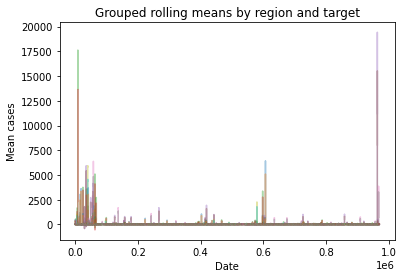

In [ ]:
grouped_temp_train.rolling_mean.plot(alpha=0.4, legend=False)
plt.title('Grouped rolling means by region and target')
plt.ylabel('Mean cases')
plt.xlabel('Date');

Graph isn't supposed to be pretty, just using to see if groupby has done as expected.<br>
Can see many different means have been created for each location point

In [ ]:
temp_train.dropna(inplace=True)

from sklearn.preprocessing import OrdinalEncoder
oe = OrdinalEncoder()
temp_train[['country_region', 'target', 'country_alpha_2', 'location','continent']] = (
    oe.fit_transform(temp_train[['country_region', 'target', 'country_alpha_2', 'location','continent']])
    )

temp_train[['country_region', 'target', 'country_alpha_2', 'location','continent']] = (
    temp_train[['country_region', 'target', 'country_alpha_2', 'location','continent']].astype('int')
)


In [ ]:
#temp_train = temp_train.set_index('date')
temp_train = temp_train.drop(['date','county','province_state'], axis=1)

#### LinearRegression shift/mean feature generation

In [ ]:
from sklearn.linear_model import LinearRegression
'''create a copy of columns to reset dataframe columns after make_features'''
column_copy = temp_train.columns.copy()


'''This function creates the columns for the dataframe'''

'''inputs set to dataframe, maximum value for shift, and what the rolling mean size should be'''
def make_features(data, max_shift, rolling_mean_size):

    '''shift feature created with max_shift as an end point.
    Column will be made for each shift feature up to max_shift'''
    for shift in range(1, max_shift + 1):
        data['shift_{}'.format(shift)] = data['targetvalue'].shift(shift)

    '''rolling mean column created with argument rolling_mean_size'''
    data['rolling_mean'] = data.groupby(['location', 'target'])['targetvalue'].shift().rolling(rolling_mean_size).mean()

In [ ]:
max_lag_list = []
rolling_mean_list = []
rmse_list = []

'''i in range(1,10) to iterate max_lag'''
for i in range(1,10):
    
    '''j in range(1,25) to iterate rolling_mean'''
    for j in range(1,25):
        
        '''call make_features function and pass data, i, j'''
        make_features(temp_train, i, j)

        '''train_test_split for data, test_size 20% of original data,
        shuffle=False so data stays chronological, random_state set for repeatability'''
        features_train, features_valid = train_test_split(
         temp_train, test_size = 0.2, shuffle=False, random_state=1)

        '''na values dropped as lag feature will generate na values'''
        features_train = features_train.dropna()
        features_valid = features_valid.dropna()

        '''features and target variables for train, valid, and test set'''
        target_train = features_train['targetvalue']
        features_train = features_train.drop(['targetvalue'], axis=1)

        target_valid = features_valid['targetvalue']
        features_valid = features_valid.drop(['targetvalue'], axis=1)
        
        '''linear regression model'''
        model = LinearRegression()
        model.fit(features_train, target_train)
        
        '''prediction using test features'''
        predict_valid = model.predict(features_valid)
        
        '''lists at top of block appended with values'''
        max_lag_list.append(i)
        rolling_mean_list.append(j)
        rmse_list.append(mean_squared_error(target_valid, predict_valid)**0.5)
        
        '''reset columns in dataframe to remove make_features'''
        #this line is probably what the warnings are
        temp_train = temp_train[column_copy]


'''dataframe created from lists at top of block'''
mse_linear_reg = pd.DataFrame({'max_lag': max_lag_list, 'rolling_mean': rolling_mean_list,
                                    'rmse': rmse_list})

'''min value for rmse to be returned'''
print(mse_linear_reg[mse_linear_reg['rmse']==mse_linear_reg['rmse'].min()])
print(mse_linear_reg.nsmallest(20, 'rmse'))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs

    max_lag  rolling_mean       rmse
97        5             2  78.856504
     max_lag  rolling_mean       rmse
97         5             2  78.856504
73         4             2  78.986736
98         5             3  78.998879
75         4             4  79.116960
99         5             4  79.116960
74         4             3  79.128363
50         3             3  79.128363
96         5             1  79.196901
72         4             1  79.318429
48         3             1  79.463204
24         2             1  79.577685
0          1             1  79.577685
25         2             2  79.606570
49         3             2  79.606570
192        9             1  80.636065
168        8             1  80.639321
144        7             1  80.971665
120        6             1  80.981117
193        9             2  81.323188
169        8             2  81.325698


### XGBRegressor shift/mean feature generation

Below takes ~50mins to run

In [ ]:

max_lag_list = []
rolling_mean_list = []
rmse_list = []

'''i in range(1,10) to iterate max_lag'''
for i in range(1,10):
    
    '''j in range(1,5) to iterate rolling_mean'''
    for j in range(1,5):
        
        '''call make_features function and pass data, i, j'''
        make_features(temp_train, i, j)

        '''train_test_split for data, test_size 20% of original data,
        shuffle=False so data stays chronological, random_state set for repeatability'''
        features_train, features_valid = train_test_split(
         temp_train, test_size = 0.2, shuffle=False, random_state=1)

        '''na values dropped as lag feature will generate na values'''
        features_train = features_train.dropna()
        features_valid = features_valid.dropna()

        '''features and target variables for train, valid, and test set'''
        target_train = features_train['targetvalue']
        features_train = features_train.drop(['targetvalue'], axis=1)

        target_valid = features_valid['targetvalue']
        features_valid = features_valid.drop(['targetvalue'], axis=1)
        
        '''linear regression model'''
        model = XGBRegressor(objective ='reg:linear', verbose=0)
        model.fit(features_train, target_train)
        
        '''prediction using test features'''
        predict_valid = model.predict(features_valid)
        
        '''lists at top of block appended with values'''
        max_lag_list.append(i)
        rolling_mean_list.append(j)
        rmse_list.append(mean_squared_error(target_valid, predict_valid)**0.5)
        
        '''reset columns in dataframe to remove make_features'''
        temp_train = temp_train[column_copy]


'''dataframe created from lists at top of block'''
mse_linear_reg = pd.DataFrame({'max_lag': max_lag_list, 'rolling_mean': rolling_mean_list,
                                    'rmse': rmse_list})

'''min value for rmse to be returned'''
print(mse_linear_reg[mse_linear_reg['rmse']==mse_linear_reg['rmse'].min()])
print(mse_linear_reg.nsmallest(20, 'rmse'))


[14:04:02] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[14:04:42] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[14:05:22] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[14:06:02] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[14:06:41] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[14:07:23] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[14:08:08] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[14:08:51] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[14:09:33] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[14:10:19] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[14:11:05] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[14:11:51] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[14:12:36] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[14:13:24] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[14:14:12] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[14:14:59] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[14:15:46] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[14:16:34] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[14:17:25] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[14:18:14] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[14:19:04] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[14:19:57] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[14:20:49] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[14:21:41] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[14:22:32] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[14:23:27] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[14:24:22] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[14:25:16] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[14:26:10] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[14:27:06] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



[14:28:02] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


### Validation predictions LR

In [ ]:
temp_train = temp_train[column_copy]

In [ ]:
make_features(temp_train, 5, 2)

'''train_test_split for data, test_size 20% of original data,
shuffle=False so data stays chronological, random_state set for repeatability'''
features_train, split_2nd = train_test_split(
  temp_train, test_size = 0.2, shuffle=False, random_state=1)

features_valid, features_test = train_test_split(
    split_2nd, test_size=0.5, shuffle=False, random_state=1
)

'''na values dropped as lag feature will generate na values'''
features_train = features_train.dropna()
features_valid = features_valid.dropna()
features_test = features_test.dropna()

'''features and target variables for train, valid, and test set'''
target_train = features_train['targetvalue']
features_train = features_train.drop(['targetvalue'], axis=1)

target_valid = features_valid['targetvalue']
features_valid = features_valid.drop(['targetvalue'], axis=1)

target_test = features_test['targetvalue']
features_test = features_test.drop(['targetvalue'], axis=1)

In [ ]:
model = LinearRegression()
model.fit(features_train, target_train)
print('RMSE train:',mean_squared_error(target_train, model.predict(features_train))**0.5)
print('RMSE valid:',mean_squared_error(target_valid, model.predict(features_valid))**0.5)
print('RMSE test:',mean_squared_error(target_test, model.predict(features_test))**0.5)

### Validation predictions XGB

In [ ]:
model = XGBRegressor(n_estimators=20000,max_depth=5,reg_lambda=0.9, random_state=1)

model.fit(features_train, target_train,
          early_stopping_rounds=300, eval_set=[(features_test, target_test)], verbose=False)
y_prediction = model.predict(features_test)

results=mean_absolute_error(target_test,y_prediction)
print(results)

In [ ]:
temp_train = temp_train[column_copy]

In [ ]:
make_features(temp_train, 3, 4)

'''train_test_split for data, test_size 20% of original data,
shuffle=False so data stays chronological, random_state set for repeatability'''
features_train, features_valid = train_test_split(
  temp_train, test_size = 0.2, shuffle=False, random_state=1)

'''na values dropped as lag feature will generate na values'''
features_train = features_train.dropna()
features_valid = features_valid.dropna()

'''features and target variables for train, valid, and test set'''
target_train = features_train['targetvalue']
features_train = features_train.drop(['targetvalue'], axis=1)

target_valid = features_valid['targetvalue']
features_valid = features_valid.drop(['targetvalue'], axis=1)

In [ ]:
xgboost = XGBRegressor(objective='reg:squarederror', verbose=0)
xgboost.fit(features_train, target_train)
print('RMSE train:',mean_squared_error(target_train, xgboost.predict(features_train))**0.5)
print('RMSE valid:',mean_squared_error(target_valid, xgboost.predict(features_valid))**0.5)
print('R2 train=',metrics.r2_score(features_valid,predict_valid))

In [ ]:
oe.transform(test[['county', 'province_state', 'country_region', 'target', 'Location']])
model.predict(test)

#ML Model <a name='ML'></a> 

## XGBRegressor + Hyperopt

In [ ]:
!pip install hyperopt
!pip install hpsklearn

In [ ]:
from hyperopt import fmin, hp, tpe, Trials, space_eval, STATUS_OK
from hyperopt.pyll.base import scope

In [ ]:
xgbr = XGBRegressor()
xgbr.fit(X_train, y_train)
y_pred = xgbr.predict(X_test)

print('MAE:', mean_absolute_error(y_pred, y_test))
print('RMSE:', mean_squared_error(y_pred, y_test)**0.5)

In [ ]:
def objective(search_space):
    model = XGBRegressor(
    **search_space,
    random_state=1)
    
    model.fit(X_train, y_train)
    
    y_pred = model.predict(X_valid)
    
    accuracy = mean_absolute_error(y_pred, y_valid)
    return {'loss': accuracy,
           'status':STATUS_OK}

           #these are the hyperparameters to tune, change to what your model includes
search_space = {
    'max_depth': scope.int(hp.quniform("max_depth", 1, 5, 1)),
    'gamma': hp.uniform ('gamma', 0,1),
    'reg_alpha' : hp.uniform('reg_alpha', 0,50),
    'reg_lambda' : hp.uniform('reg_lambda', 10,100),
    'colsample_bytree' : hp.uniform('colsample_bytree', 0,1),
    'min_child_weight' : hp.uniform('min_child_weight', 0, 5),
    'n_estimators': hp.randint('n_estimators', 200, 20000),
    'learning_rate': hp.uniform('learning_rate', 0, .15),
    'tree_method':'hist', #could use gpu_hist if available
    'gpu_id': 0,
    'max_bin' : scope.int(hp.quniform('max_bin', 200, 550, 1))
               }

algorithm = tpe.suggest

best_params = fmin(
fn=objective,
space=search_space,
algo=algorithm,
max_evals=200) #drop max_evals to lower runtime, 200 attempts at tuning

In [ ]:
print(best_params)

In [ ]:
params = {
    'colsample_bytree': 0.876757749200749,
          'gamma': 0.06511761363728052,
          'learning_rate': 0.009024597551563221,
          'max_bin': 523.0,
          'max_depth': 5.0,
          'min_child_weight': 3.925009587666903,
          'n_estimators': 435,
          'reg_alpha': 17.58510396534354,
          'reg_lambda': 41.20106007831344
         }

In [ ]:
best_xgb = XGBRegressor(params=params, random_state=1)
best_xgb.fit(X_train, y_train)

In [ ]:
y_pred = best_xgb.predict(X_test)

In [ ]:
print('MAE:', mean_absolute_error(y_test, y_pred))
print('RMSE:', mean_squared_error(y_test, y_pred)**0.5)

MSE: 3.5773795607209973 <br>
RMSE: 54.37627441780612

### Polynomial Features

In [ ]:
from sklearn.preprocessing import PolynomialFeatures

In [ ]:
poly = PolynomialFeatures(2)
X_train_poly = poly.fit_transform(X_train)
X_test_poly = poly.transform(X_test)

In [ ]:
best_xgb = XGBRegressor(params=params, random_state=1)
best_xgb.fit(X_train_poly, y_train)

In [ ]:
y_pred = best_xgb.predict(X_test_poly)

In [ ]:
print('MSE:', mean_absolute_error(y_test, y_pred))
print('RMSE:', mean_squared_error(y_test, y_pred)**0.5)

### Building the Multi Layer Perception regression model

In [ ]:
from sklearn.neural_network import MLPRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error


def model_fit(regs):
    fitted_model={}
    model_result = pd.DataFrame()
    for model_name, model in regs.items():
        model.fit(X_train,y_train)
        fitted_model.update({model_name:model})
        #y_pred = model.predict(X_test)
        model_dict = {}
        model_dict['1.Algorithm'] = model_name
        model_dict['2.RMSE_Train'] = round(mean_squared_error(y_train, model.predict(X_train), squared = False),2)
        model_dict['3.RMSE_Test'] = round(mean_squared_error(y_test, model.predict(X_test), squared = False),2)
        model_dict['4.MAE_Train'] = round(mean_absolute_error(y_train, model.predict(X_train)),2)
        model_dict['5.MAE_Test'] = round(mean_absolute_error(y_test, model.predict(X_test)),2)
        model_result = model_result.append(model_dict,ignore_index=True)
    return fitted_model, model_result

regs = {"MLPRegressor_default":MLPRegressor(random_state=1, max_iter=200)}







In [ ]:
fitted_model, model_result = model_fit(regs)

In [ ]:
model_result.sort_values(by=['2.RMSE_Train'],ascending=True)

##RandomForest

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
pipeline_dt = Pipeline([('scaler2' , StandardScaler()),
                        ('RandomForestRegressor: ', RandomForestRegressor())])
pipeline_dt.fit(X_train , y_train)
prediction = pipeline_dt.predict(X_test)


In [ ]:
score = pipeline_dt.score(X_test, y_test)
print('Score: ' + str(score))
# Score: 0.9674437518275933

Score: 0.9674437518275933


In [ ]:
from sklearn import metrics
from sklearn.metrics import mean_absolute_error
print('RMSE valid:',mean_squared_error(prediction,y_test)**0.5)
val_mae = mean_absolute_error(prediction,y_test)
print('MAE valid:', val_mae)

# RMSE valid: 52.58003961388158
# MAE valid: 3.648201569128793

RMSE valid: 52.58003961388158
MAE valid: 3.648201569128793


##LightGBM

In [ ]:
import lightgbm as lgb
!pip install lightgbm
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split
from lightgbm import LGBMRegressor 
from sklearn import metrics
from sklearn.model_selection import RandomizedSearchCV

In [ ]:
# Using Randomized Search CV for model tuning

params_grid = {
    'learning_rate': [0.004, 0.005, 0.006],
    'feature_fraction': [0.2, 0.4, 0.6, 0.8],
    'bagging_fraction': [0.2, 0.4, 0.6, 0.8],
    "max_depth": [5, 10, 15, 20],
    "num_leaves": [16, 32, 64,128],
    "max_bin": [32, 64, 100]
}

lgbm_cv = RandomizedSearchCV(estimator=lgb.LGBMRegressor(), 
                             param_distributions=params_grid, 
                             cv = 5, 
                             n_iter=100,
                             verbose=1)

lgbm_cv.fit(X_train, y_train)

Fitting 5 folds for each of 100 candidates, totalling 500 fits


RandomizedSearchCV(cv=5, estimator=LGBMRegressor(), n_iter=100,
                   param_distributions={'bagging_fraction': [0.2, 0.4, 0.6,
                                                             0.8],
                                        'feature_fraction': [0.2, 0.4, 0.6,
                                                             0.8],
                                        'learning_rate': [0.004, 0.005, 0.006],
                                        'max_bin': [32, 64, 100],
                                        'max_depth': [5, 10, 15, 20],
                                        'num_leaves': [16, 32, 64, 128]},
                   verbose=1)

In [ ]:
print("Best model parameters: ", lgbm_cv.best_params_)
# Training model with best parameters
best_params = lgbm_cv.best_params_

params = {
    'learning_rate': best_params['learning_rate'],
    'feature_fraction': best_params['feature_fraction'],
    'bagging_fraction': best_params['bagging_fraction'],
    "max_depth": best_params['max_depth'],
    "num_leaves": best_params['num_leaves'],
    "max_bin": best_params['max_bin']
}

lgbm = lgb.LGBMRegressor(**params)

lgbm.fit(X_train, y_train)

Best model parameters:  {'num_leaves': 128, 'max_depth': 20, 'max_bin': 32, 'learning_rate': 0.006, 'feature_fraction': 0.8, 'bagging_fraction': 0.4}


LGBMRegressor(bagging_fraction=0.4, feature_fraction=0.8, learning_rate=0.006,
              max_bin=32, max_depth=20, num_leaves=128)

In [ ]:
y_pred = lgbm.predict(X_test)

print("Root Mean Squared Error: ", round(mean_squared_error(y_test, y_pred)**0.5, 2))
print("Mean Absolute Error: ", round(mean_absolute_error(y_test, y_pred), 2))
print("R2: ", round(metrics.r2_score(y_test, y_pred), 2))

Root Mean Squared Error:  240.87
Mean Absolute Error:  13.57
R2:  0.32


##Linear Regression Model

In [ ]:
from sklearn.linear_model import LinearRegression
model = LinearRegression()
model.fit(X_train, y_train)
print('RMSE train:',mean_squared_error(y_train, model.predict(X_train))**0.5)
print('RMSE test:',mean_squared_error(y_test, model.predict(X_test))**0.5)
print("MAE train: ", round(mean_absolute_error(y_train, model.predict(X_train)), 2))
print("MAE test: ", round(mean_absolute_error(y_test, model.predict(X_test)), 2))
# RMSE train: 69.8476941359348
# RMSE valid: 47.65099733127677

RMSE train: 69.8476941359348
RMSE test: 47.65099733127677
MAE train:  3.37
MAE test:  3.53


## Decision Tree Regressor

In [ ]:
#Feature selection by ExtraTreesRegressor(model based). 
#ExtraTreesRegressor helps us find the features which are most important.
# Feature selection by ExtraTreesRegressor(model based)

from sklearn.ensemble import ExtraTreesRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score as acc
from sklearn import metrics

reg= ExtraTreesRegressor()
reg.fit(X_train,y_train)


array([4.50569981e-03, 4.31213808e-03, 5.51711274e-03, 1.16688251e-04,
       4.51738551e-01, 3.07262566e-01, 1.72095637e-01, 5.44516076e-02])

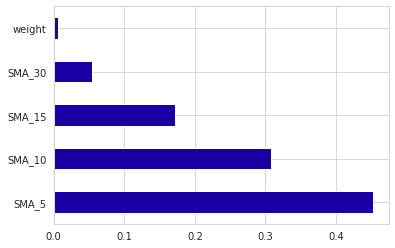

In [ ]:
feat_importances = pd.Series(reg.feature_importances_, index=X_train.columns)
feat_importances.nlargest().plot(kind='barh')
plt.show()

In [ ]:
from sklearn.tree import DecisionTreeRegressor
reg_decision_model=DecisionTreeRegressor()

# fit independent varaibles to the dependent variables
reg_decision_model.fit(X_train,y_train)

reg_decision_model.score(X_train,y_train)
#Score for train dataset is 0.9999

0.9999972698882511

In [ ]:
reg_decision_model.score(X_test,y_test)
#Score for test dataset is 0.8989

0.8989306915129935

### Hyper Parameter Tuning for Decision Tree Regressor

In [ ]:
prediction=reg_decision_model.predict(X_test)

In [ ]:
# Hyper parameters range intialization for tuning 
parameters={"splitter":["best","random"],
            "max_depth" : [1,3,5,7,9,11,12],
           "min_samples_leaf":[1,2,3,4,5,6,7,8,9,10],
           "min_weight_fraction_leaf":[0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9],
           "max_features":["auto","log2","sqrt",None],
           "max_leaf_nodes":[None,10,20,30,40,50,60,70,80,90] }

In [ ]:
# calculating different regression metrics
from sklearn.model_selection import GridSearchCV
tuning_model=GridSearchCV(reg_decision_model,param_grid=parameters,scoring='neg_mean_squared_error',cv=3,verbose=3)

In [ ]:
tuning_model.fit(X_train,y_train)

Streaming output truncated to the last 5000 lines.
[CV 2/3] END max_depth=12, max_features=None, max_leaf_nodes=None, min_samples_leaf=8, min_weight_fraction_leaf=0.4, splitter=random;, score=-2319.432 total time=   0.1s
[CV 3/3] END max_depth=12, max_features=None, max_leaf_nodes=None, min_samples_leaf=8, min_weight_fraction_leaf=0.4, splitter=random;, score=-138710.749 total time=   0.1s
[CV 1/3] END max_depth=12, max_features=None, max_leaf_nodes=None, min_samples_leaf=8, min_weight_fraction_leaf=0.5, splitter=best;, score=-136317.388 total time=   0.2s
[CV 2/3] END max_depth=12, max_features=None, max_leaf_nodes=None, min_samples_leaf=8, min_weight_fraction_leaf=0.5, splitter=best;, score=-2053.898 total time=   0.3s
[CV 3/3] END max_depth=12, max_features=None, max_leaf_nodes=None, min_samples_leaf=8, min_weight_fraction_leaf=0.5, splitter=best;, score=-138851.512 total time=   0.2s
[CV 1/3] END max_depth=12, max_features=None, max_leaf_nodes=None, min_samples_leaf=8, min_weight_f

/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py:372: FitFailedWarning:


67200 fits failed out of a total of 151200.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
67200 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/sklearn/model_selection/_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.7/dist-packages/sklearn/tree/_classes.py", line 1320, in fit
    X_idx_sorted=X_idx_sorted,
  File "/usr/local/lib/python3.7/dist-packages/sklearn/tree/_classes.py", line 304, in fit
    raise ValueError("min_weight_fraction_leaf must in [0, 0.5]")
ValueError: min_weight_frac

GridSearchCV(cv=3, estimator=DecisionTreeRegressor(),
             param_grid={'max_depth': [1, 3, 5, 7, 9, 11, 12],
                         'max_features': ['auto', 'log2', 'sqrt', None],
                         'max_leaf_nodes': [None, 10, 20, 30, 40, 50, 60, 70,
                                            80, 90],
                         'min_samples_leaf': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10],
                         'min_weight_fraction_leaf': [0.1, 0.2, 0.3, 0.4, 0.5,
                                                      0.6, 0.7, 0.8, 0.9],
                         'splitter': ['best', 'random']},
             scoring='neg_mean_squared_error', verbose=3)

In [ ]:
# best hyperparameters 
tuning_model.best_params_

{'max_depth': 9,
 'max_features': 'log2',
 'max_leaf_nodes': 80,
 'min_samples_leaf': 5,
 'min_weight_fraction_leaf': 0.1,
 'splitter': 'best'}

In [ ]:
# best model score
tuning_model.best_score_

-90802.76266308781

###Training Decision Tree With Best Hyperparameters


In [ ]:
tuned_hyper_model= DecisionTreeRegressor(max_depth=5,max_features='auto',max_leaf_nodes=50,min_samples_leaf=2,min_weight_fraction_leaf=0.1,splitter='random')

In [ ]:
# fitting model
tuned_hyper_model.fit(X_train,y_train)

DecisionTreeRegressor(max_depth=5, max_features='auto', max_leaf_nodes=50,
                      min_samples_leaf=2, min_weight_fraction_leaf=0.1,
                      splitter='random')

In [ ]:
tuned_pred=tuned_hyper_model.predict(X_test) # Tuned prediction

In [ ]:
# With hyperparameter tuned 

from sklearn import metrics
print('MAE:', metrics.mean_absolute_error(y_test,tuned_pred))
print('MSE:', metrics.mean_squared_error(y_test, tuned_pred))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, tuned_pred)))

MAE: 21.925943261354277
MSE: 84784.87745656267
RMSE: 291.17842889981165


In [ ]:
reg_decision_model.score(X_test,tuned_pred)


-373.9505517199921

In [ ]:
# without hyperparameter tuning 
print('MAE:', metrics.mean_absolute_error(y_test,prediction))
print('MSE:', metrics.mean_squared_error(y_test, prediction))
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, prediction)))

MAE: 5.54690843942966
MSE: 8582.7559154455
RMSE: 92.64316442914448


##Gradient boost

In [ ]:
gradientregressor=GradientBoostingRegressor(max_depth=2,n_estimators=50,learning_rate=1.0)

In [ ]:
model=gradientregressor.fit(X_train,y_train)
y_pred=model.predict(X_test)

In [ ]:
from sklearn.metrics import r2_score
r2_score(y_pred,y_test)

0.9034502818608611

In [ ]:
y_pred

array([ 0.28700136,  0.28700136,  0.28700136, ...,  0.28700136,
       21.41298682,  0.28700136])

In [ ]:
from sklearn.metrics import mean_absolute_error,mean_squared_error

In [ ]:
mae_model=mean_absolute_error(y_test,y_pred)

mse_model=mean_squared_error(y_test,y_pred)

print(f"mae_model:{mae_model} ")
print(f"mse_model: {mse_model}")


mae_model:4.44031499408319 
mse_model: 5517.406145859231


In [ ]:
from sklearn.metrics import mean_squared_error
from math import sqrt

In [ ]:
print('root mean square value :' ,sqrt(mean_squared_error(y_test,y_pred)))

root mean square value : 74.27924438131578


In [ ]:
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier

In [ ]:
features=model.feature_importances_
features

array([5.73960273e-04, 4.34997844e-04, 4.41430113e-05, 0.00000000e+00,
       9.44874645e-01, 3.59407835e-02, 8.21594174e-03, 9.91552842e-03])

In [ ]:
X_train.columns

Index(['country_region', 'population', 'weight', 'target', 'SMA_5', 'SMA_10',
       'SMA_15', 'SMA_30'],
      dtype='object')

In [ ]:
columns=X_train.columns

In [ ]:
graph=pd.Series(features,columns)
graph

country_region    0.000574
population        0.000435
weight            0.000044
target            0.000000
SMA_5             0.944875
SMA_10            0.035941
SMA_15            0.008216
SMA_30            0.009916
dtype: float64

In [ ]:
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure

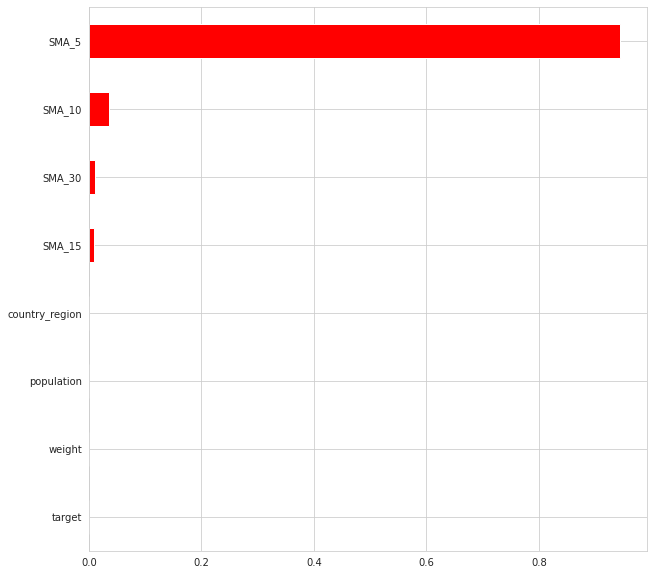

In [ ]:
figure(figsize=(10,10))
graph.sort_values().plot.barh(color='red')